### Here we use differnt window sizes (500msec, 300msec, 800msec, 1sec,  2sec, 3sec) for the training of the mdoels and extract saliency maps 

In [1]:
from tqdm import tqdm
import torch
from torch import nn
from torch.nn import functional as F
from torch.nn.modules.module import Module
from sklearn.preprocessing import OneHotEncoder

In [2]:
"""read raw data from matlab saved format to numpy arrays and save on disk"""
from read_data import read_save
read_save()

In [3]:
"""train test split the data (50% test data)"""
from read_data import tr_test_split
train_data_files, test_data_files = tr_test_split(0.5)

## Window size : 500. Classification of Control vs MCI

In [4]:
"""build data features and connectivity bands, 
Here the duration of each epoch is 500 msec and
the calculated connectivity is correlation"""
from read_data import build_data
train_X, train_graphs, train_y = build_data(train_data_files, size=500, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=500, cal_conn="corr", bands=True)

100%|███████████████████████████████████████████| 84/84 [04:52<00:00,  3.49s/it]


In [5]:
"""stacks all features into each first dimension"""
from read_data import stack_arrays
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

In [6]:
"""standardize the data and calculate the laplacians of the adjacency matrix"""
from process import label2skip, uniform, standardize_data, get_lap
train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 2911/2911 [00:10<00:00, 278.30it/s]


In [7]:
"""onehot encoding of the labels, building pytorch dataloader and training """
from sklearn.preprocessing import OneHotEncoder
from process import data_loader
from train import trainer

DEVICE = torch.device("cpu")
BATCH_SIZE = 200

encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:23<00:00,  1.18s/it]


In [8]:
"""evaluate the model on train and test data"""
from evaluate import cal_accuracy

print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[3010    0]
 [   0 1212]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1936    0]
 [   0  975]]


In [12]:
"""generate the feature saliency maps for the model using the test data"""

from explain import build_maps
import numpy as np
node_importances = []
for i in tqdm(range(test_X.shape[0])):
    node_imp=build_maps(X=test_X, graphs=test_graphs, y=test_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 2911/2911 [00:08<00:00, 335.45it/s]


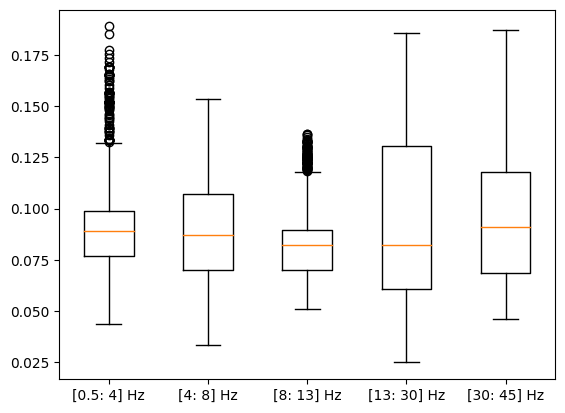

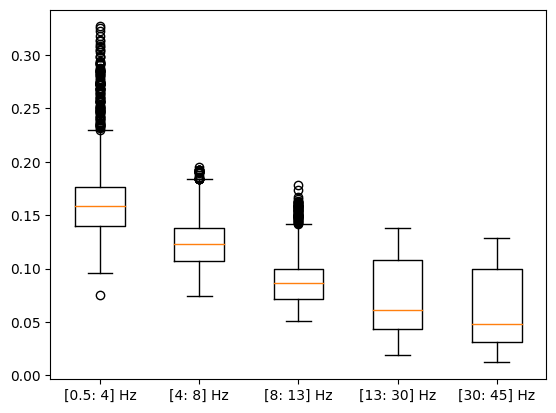

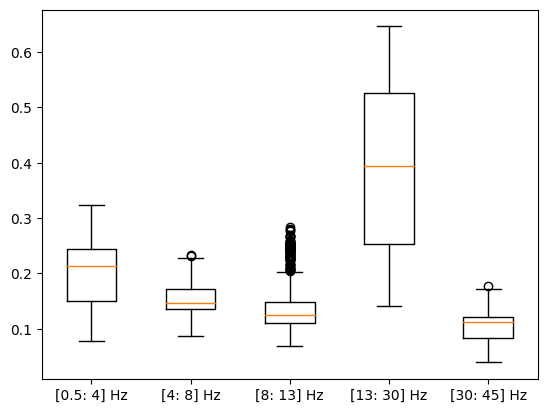

In [13]:
"""show the bands importances boxplot of first three channels"""
import matplotlib.pyplot as plt
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2) 
for i  in range(3):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

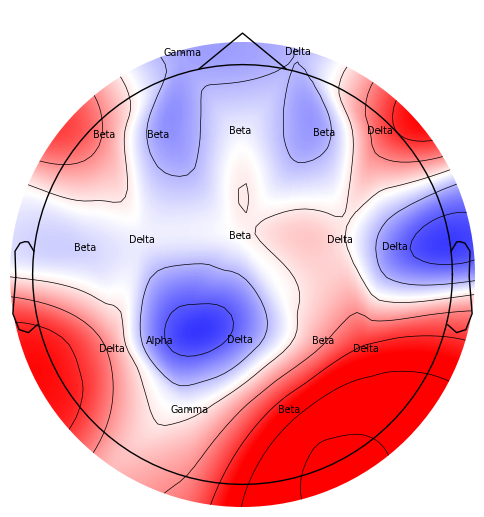

In [14]:
"""better visuzualization of bands importances vs brain regions"""
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

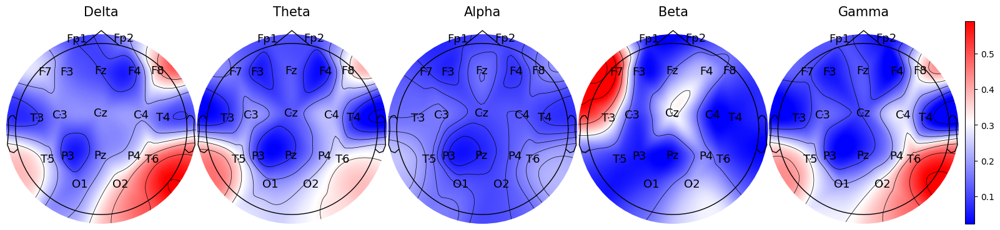

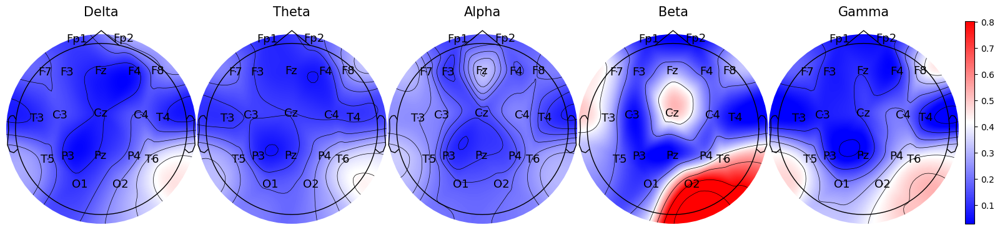

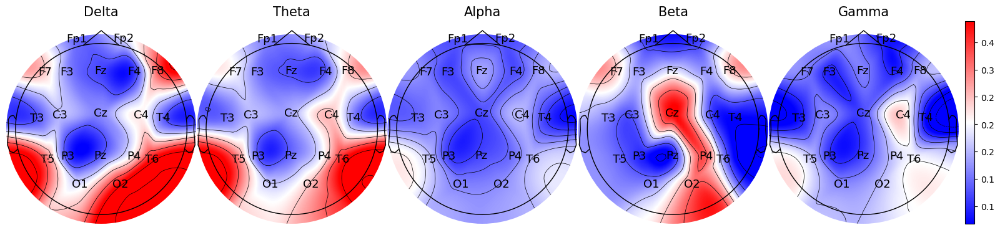

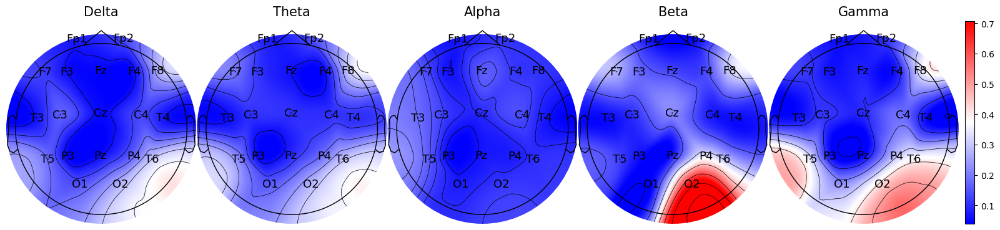

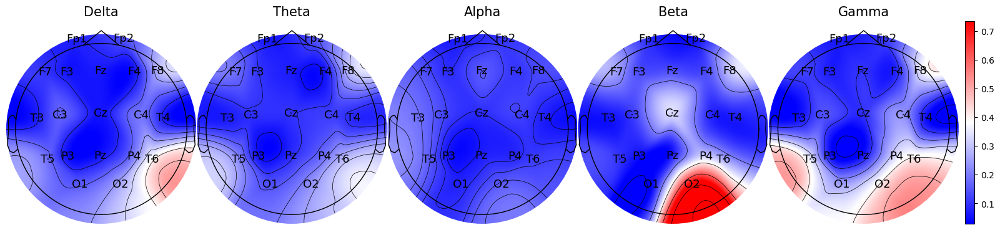

In [15]:
"""taking random epochs from the test dataset and visualize the saleincy maps for nodes"""
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))
    
from plot import plot_frequency_bands_graphs
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="500_"+str(rand_idx))

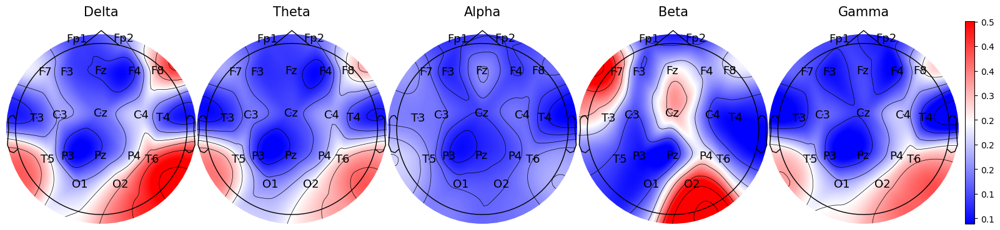

In [16]:
"""average the node importances pver the whole dataset epochs"""
node_importances = np.mean(node_importances, axis=0)
import matplotlib.pyplot as plt
plot_frequency_bands_graphs(node_importances, sub="500_avg")

100%|██████████████████████████████████████| 2911/2911 [00:09<00:00, 313.12it/s]


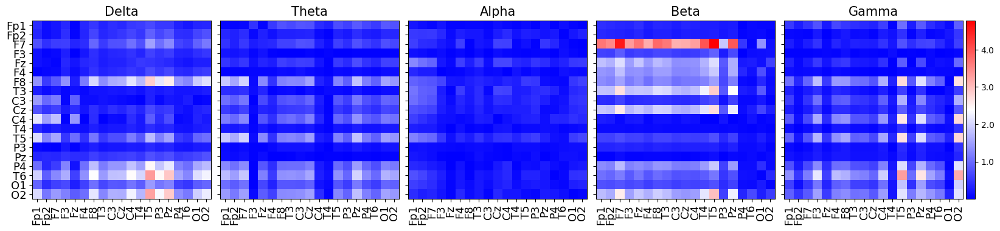

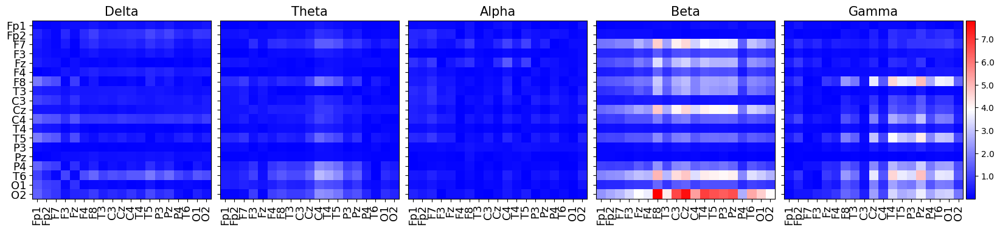

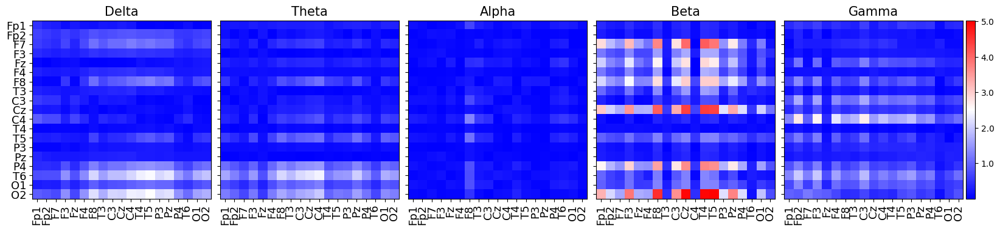

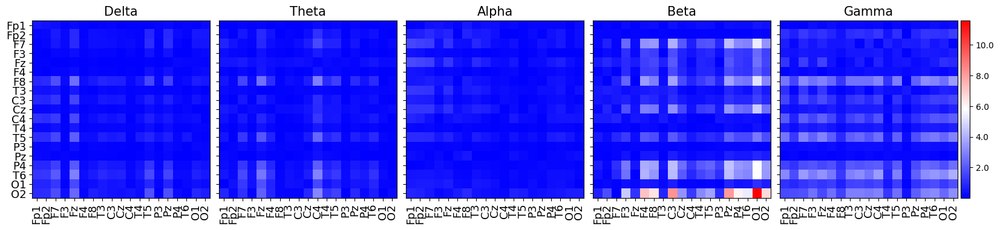

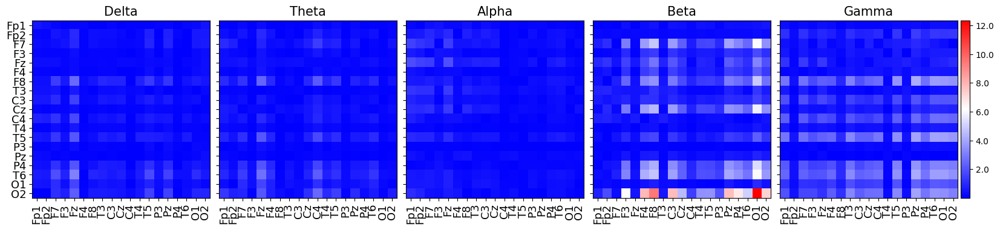

In [18]:
"""eppochs importances for the randomly chosen epochs from the testset"""
edge_importances = []
for i in tqdm(range(test_X.shape[0])):
    edge_imp = build_maps(X=test_X, graphs=test_graphs, y=test_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

from plot import plot_edges
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="500_"+str(rand_idx))

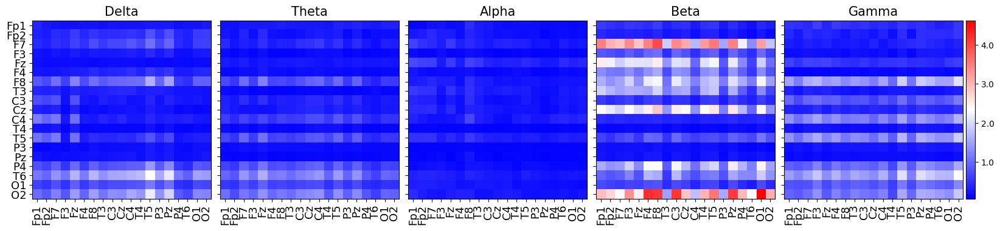

In [19]:
"""eppochs importances average out over the whole testset saliency maps"""
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="500_avg")

## Window size : 300. Classification of Control vs MCI

In [20]:
train_X, train_graphs, train_y = build_data(train_data_files, size=300, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=300, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 4894/4894 [00:17<00:00, 274.16it/s]


In [21]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()
train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)
model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:41<00:00,  2.06s/it]


In [22]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[5074    0]
 [   0 2023]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[3268    0]
 [   0 1626]]


In [23]:
node_importances = []
for i in tqdm(range(test_X.shape[0])):
    node_imp=build_maps(X=test_X, graphs=test_graphs, y=test_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 4894/4894 [00:16<00:00, 304.37it/s]


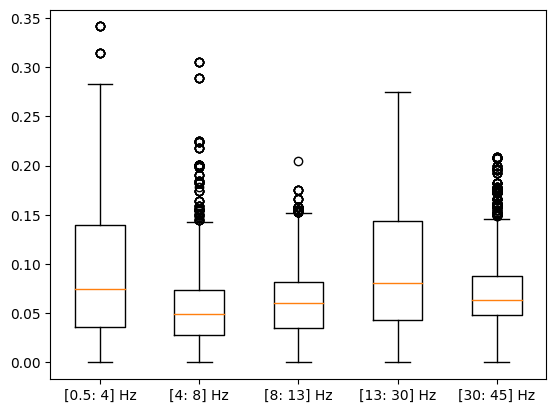

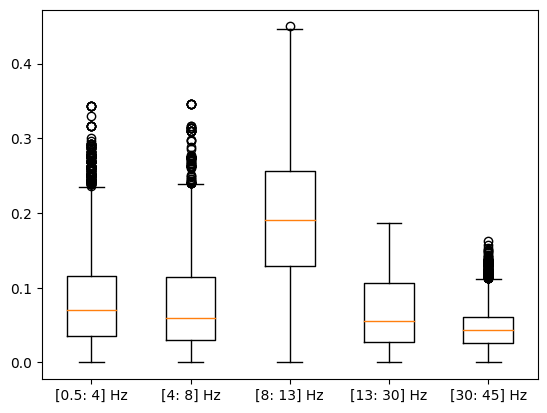

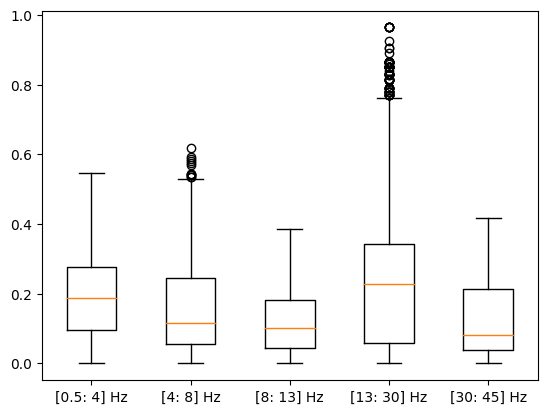

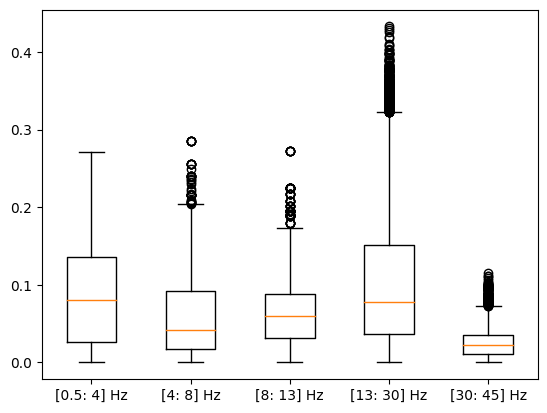

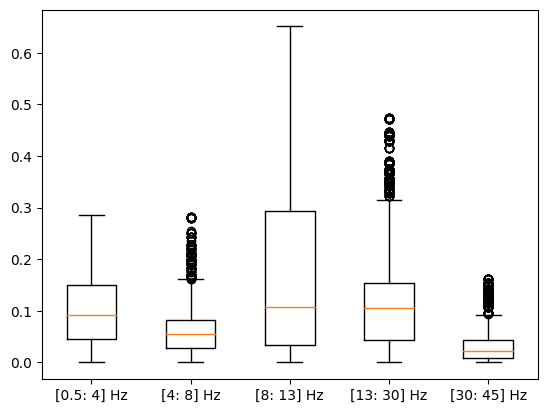

...

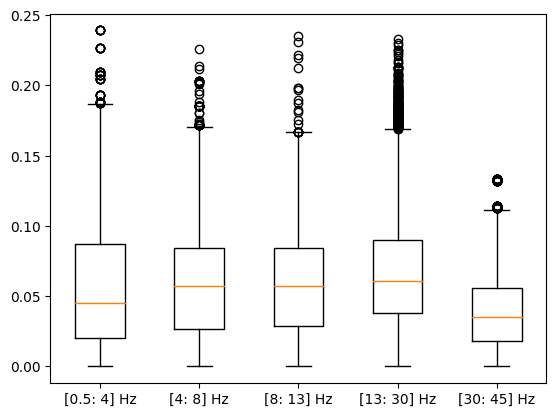

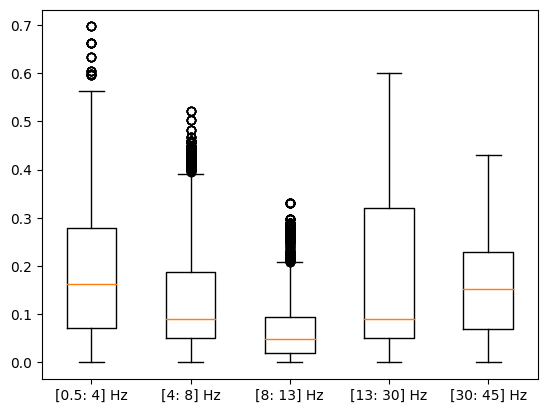

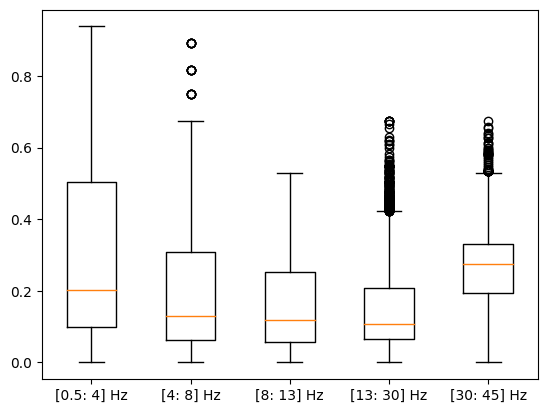

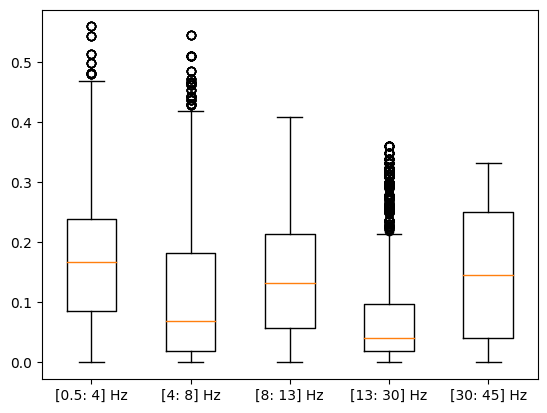

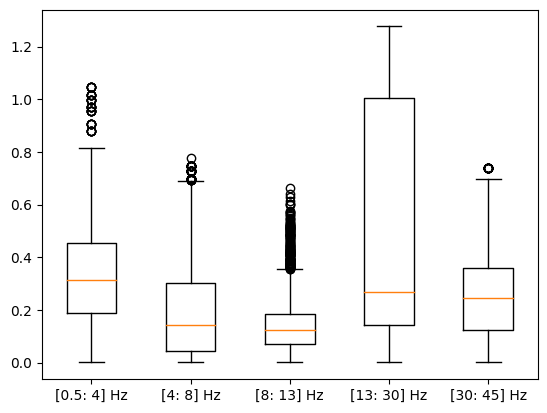

In [24]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2) 
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances[:, i, 6, :])
    ax.set_xticklabels(xticks)

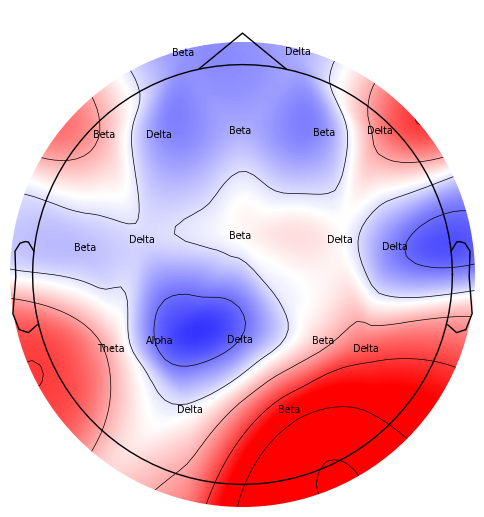

In [25]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [26]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

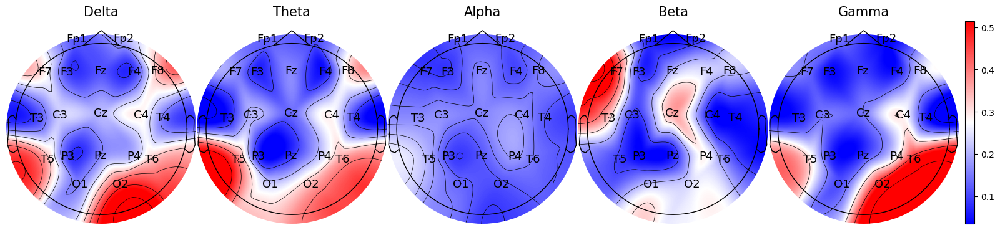

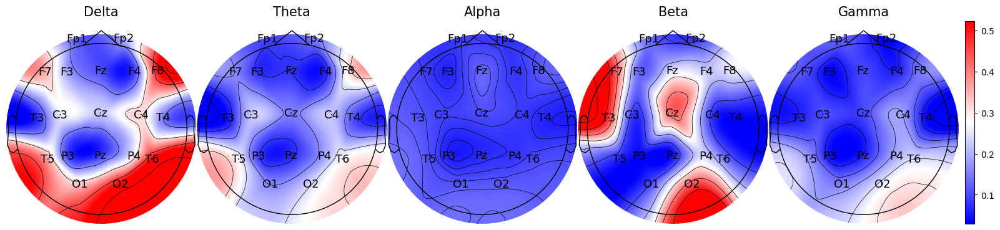

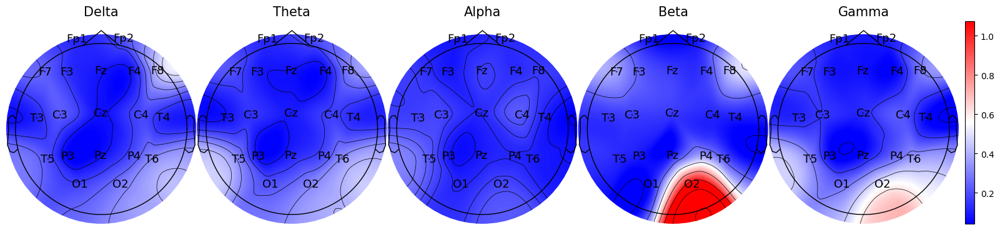

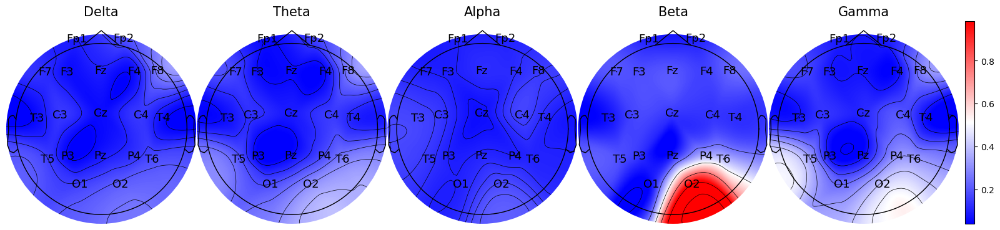

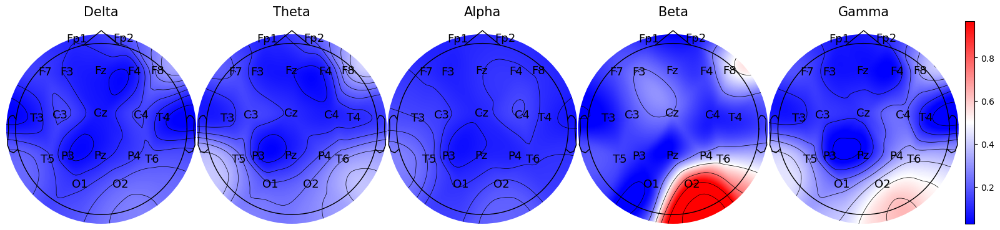

In [27]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="500_"+str(rand_idx))

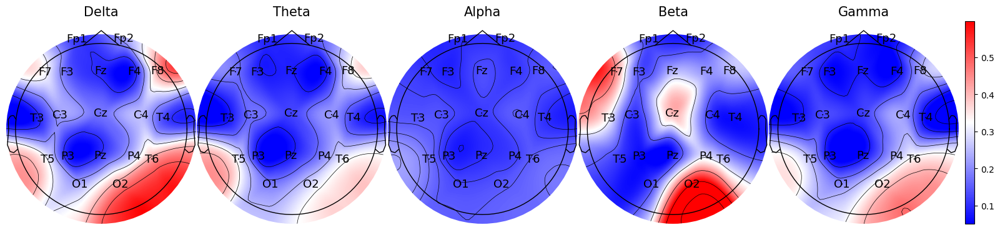

In [28]:
node_importances = np.mean(node_importances, axis=0)
import matplotlib.pyplot as plt
plot_frequency_bands_graphs(node_importances, sub="300_avg")

In [29]:
edge_importances = []
for i in tqdm(range(test_X.shape[0])):
    edge_imp = build_maps(X=test_X, graphs=test_graphs, y=test_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 4894/4894 [00:15<00:00, 306.64it/s]


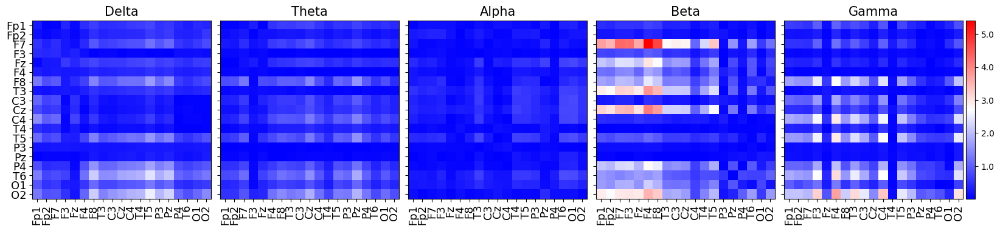

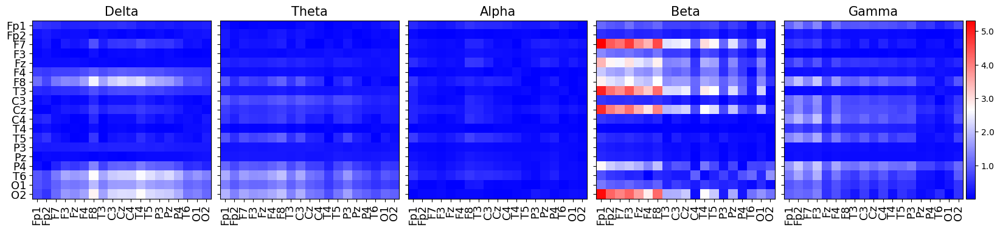

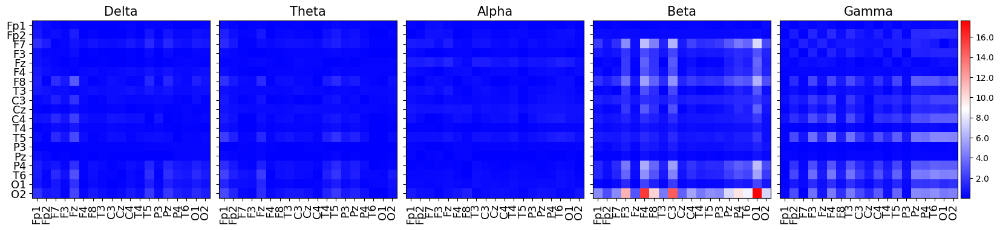

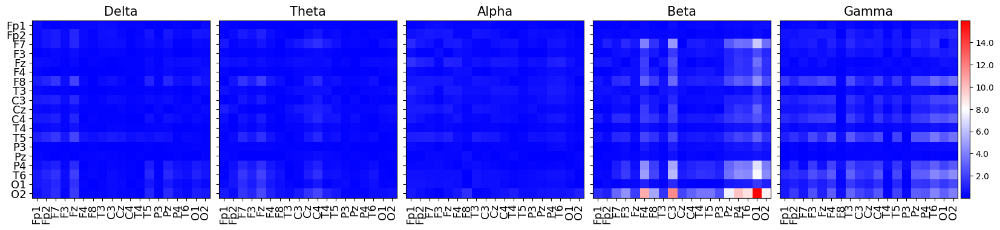

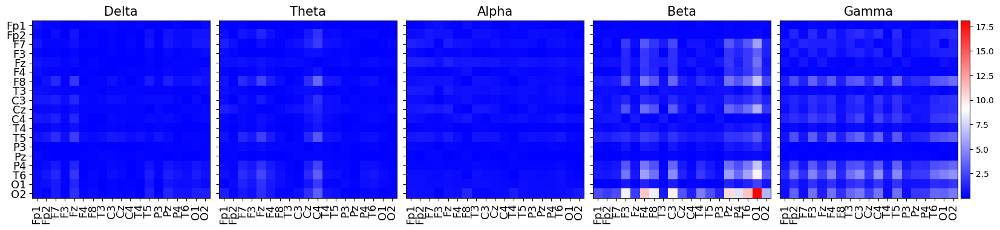

In [30]:
from plot import plot_edges
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="300_"+str(rand_idx))

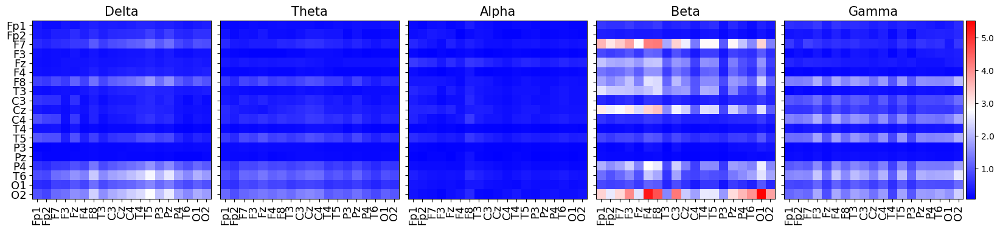

In [31]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="300_avg")

## Window size : 1000. Classification of Control vs MCI

In [32]:
train_X, train_graphs, train_y = build_data(train_data_files, size=1000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=1000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 1440/1440 [00:05<00:00, 278.24it/s]


In [33]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:11<00:00,  1.73it/s]


In [34]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1486    0]
 [   0  602]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[954   0]
 [  0 486]]


In [35]:
node_importances = []
for i in tqdm(range(test_X.shape[0])):
    node_imp=build_maps(X=test_X, graphs=test_graphs, y=test_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 1440/1440 [00:04<00:00, 342.54it/s]


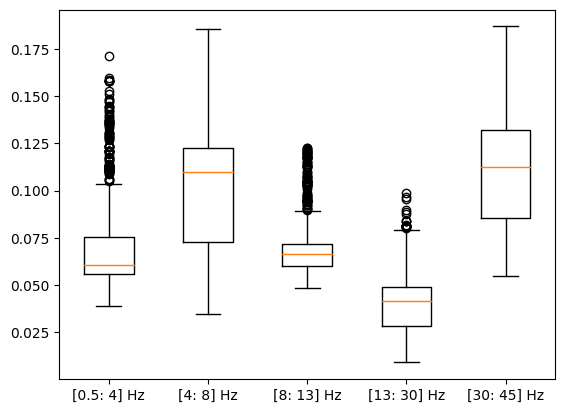

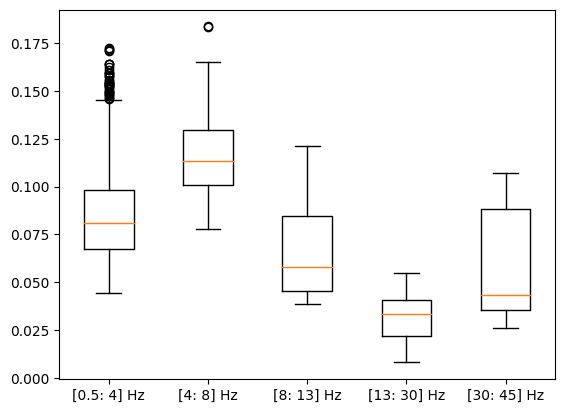

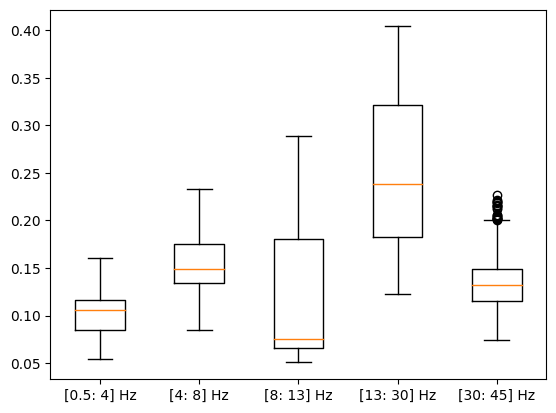

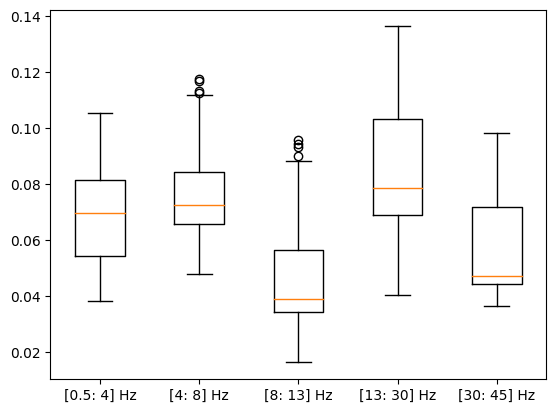

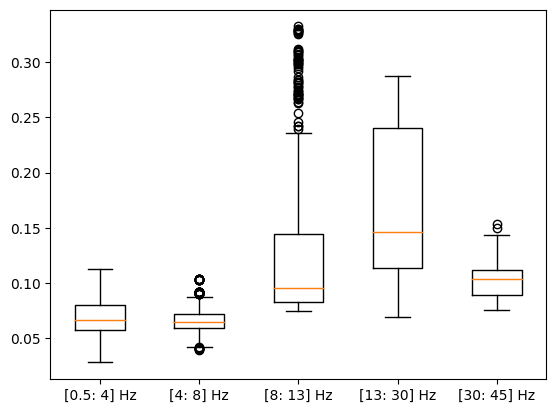

...

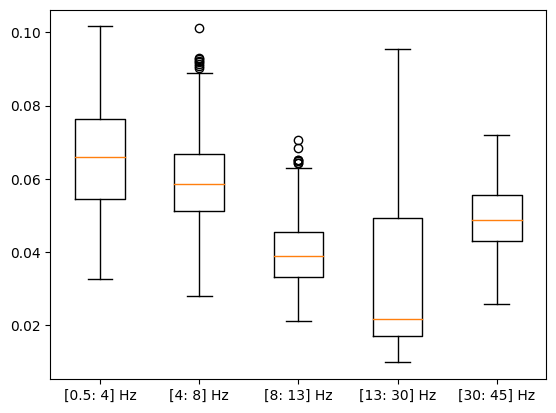

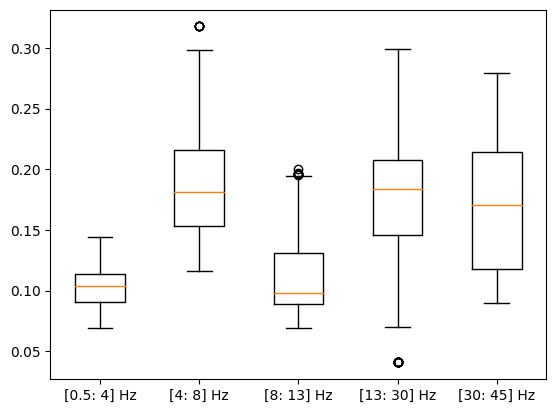

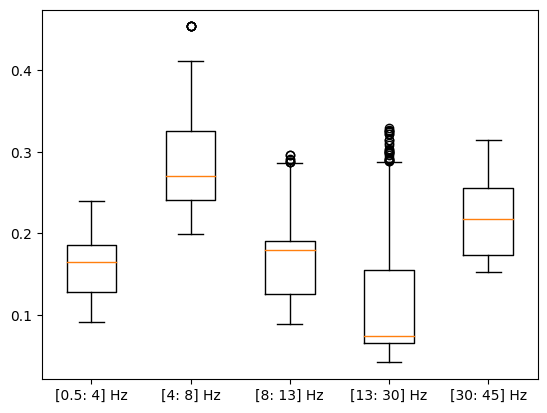

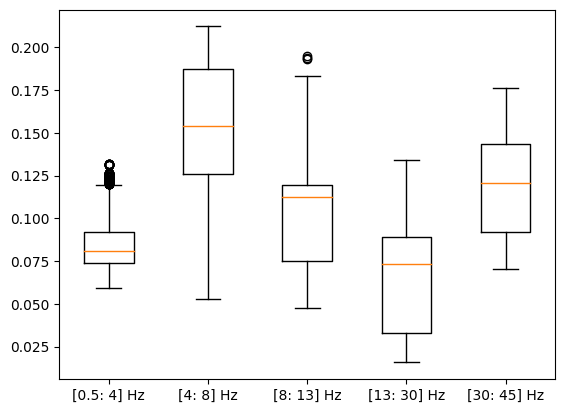

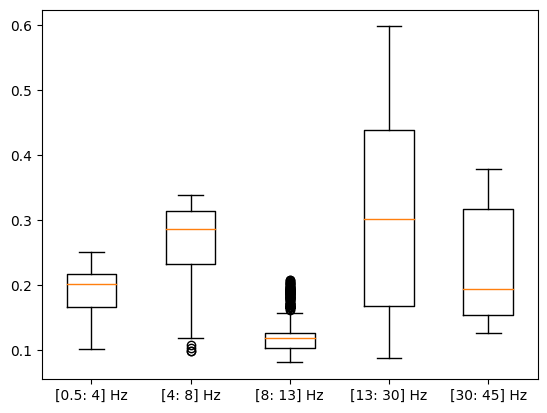

In [36]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

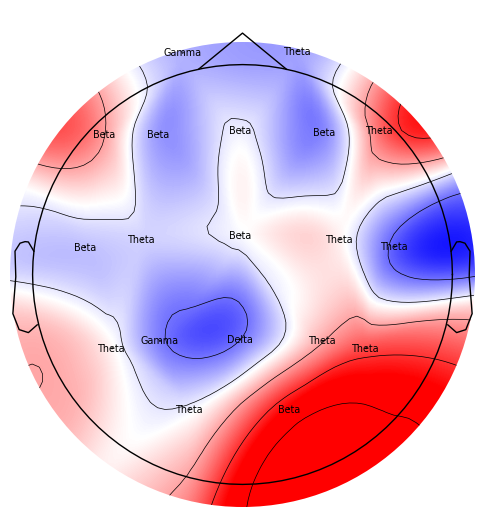

In [37]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [38]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

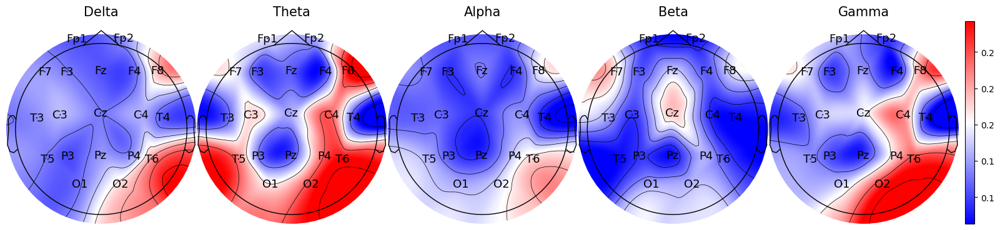

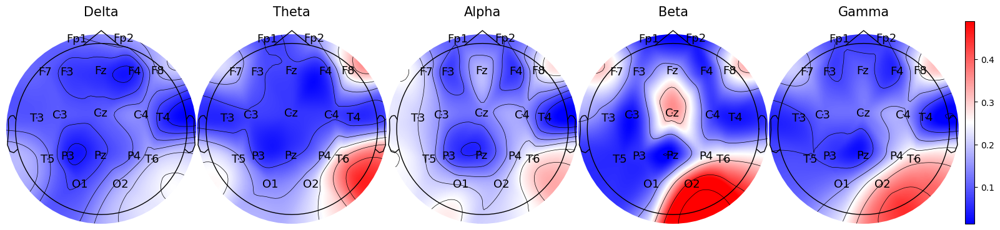

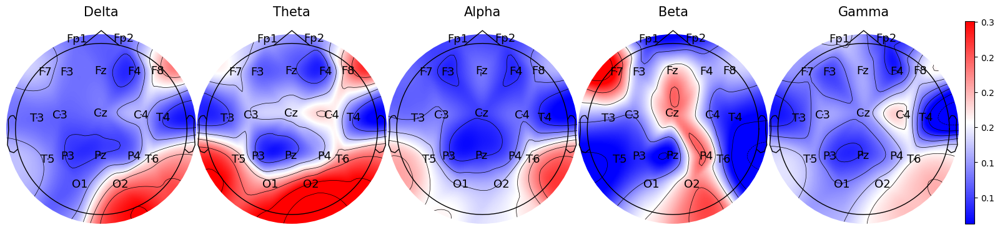

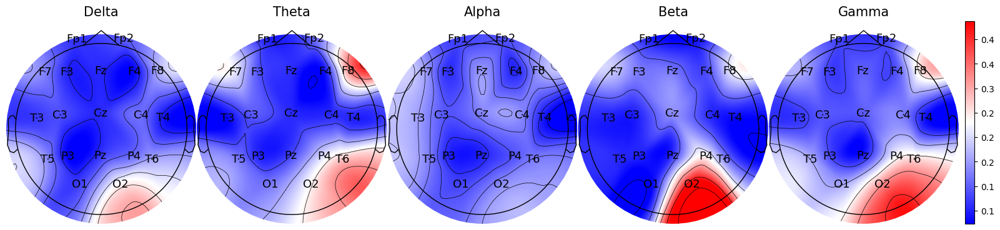

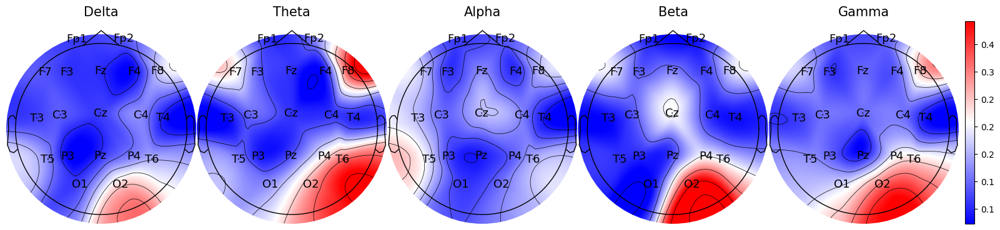

In [39]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="1000_"+str(rand_idx))

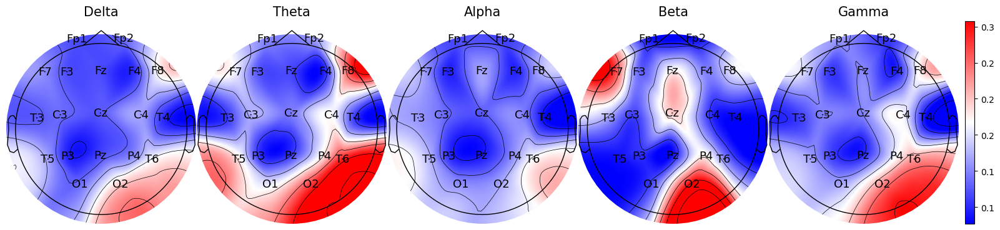

In [40]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="1000_avg")

In [41]:
edge_importances = []
for i in tqdm(range(test_X.shape[0])):
    edge_imp = build_maps(X=test_X, graphs=test_graphs, y=test_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 1440/1440 [00:04<00:00, 329.20it/s]


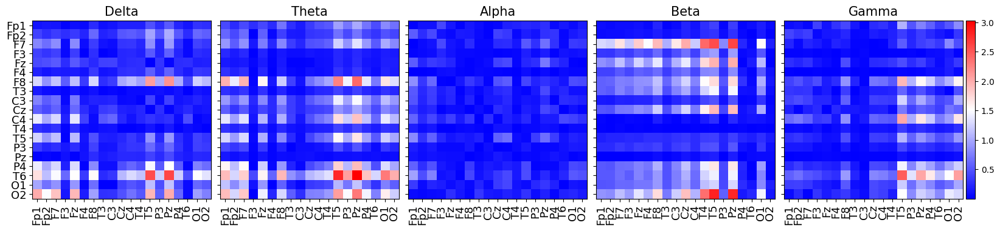

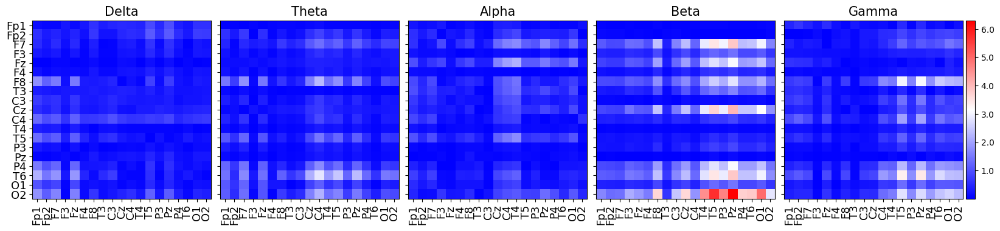

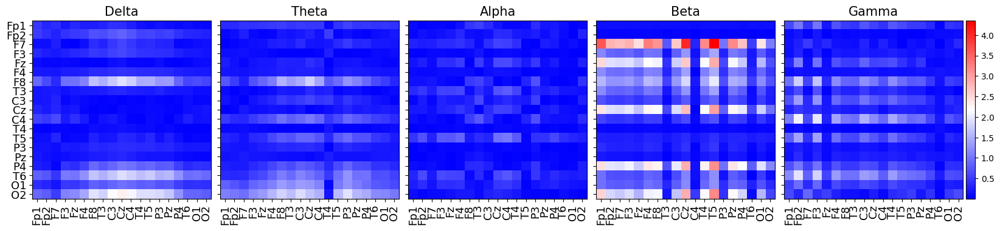

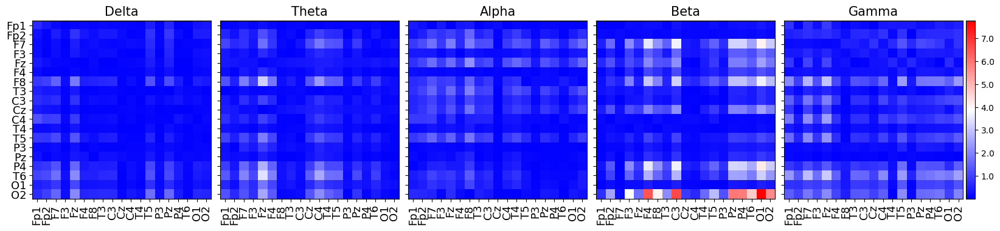

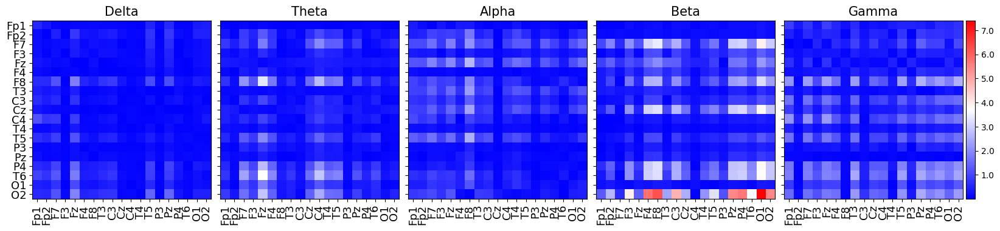

In [42]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="1000_"+str(rand_idx))

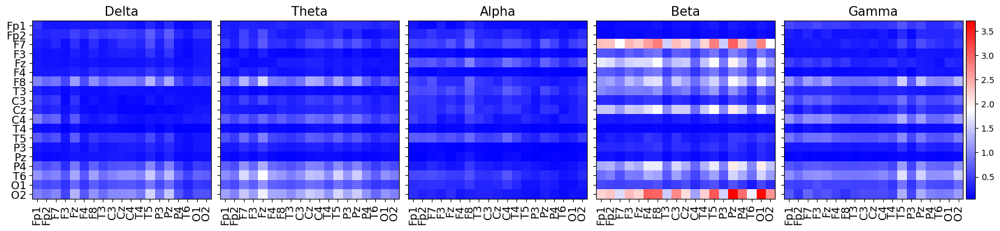

In [43]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="1000_avg")

## Window size : 800. Classification of Control vs MCI

In [44]:
train_X, train_graphs, train_y = build_data(train_data_files, size=800, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=800, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|██████████████████████████████████████| 1802/1802 [00:06<00:00, 281.03it/s]


In [45]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:14<00:00,  1.41it/s]


In [46]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1860    0]
 [   0  754]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[1194    0]
 [   0  608]]


In [47]:
node_importances = []
for i in tqdm(range(test_X.shape[0])):
    node_imp=build_maps(X=test_X, graphs=test_graphs, y=test_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|██████████████████████████████████████| 1802/1802 [00:05<00:00, 339.30it/s]


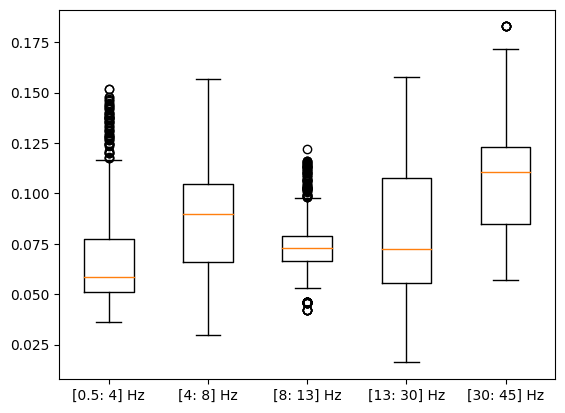

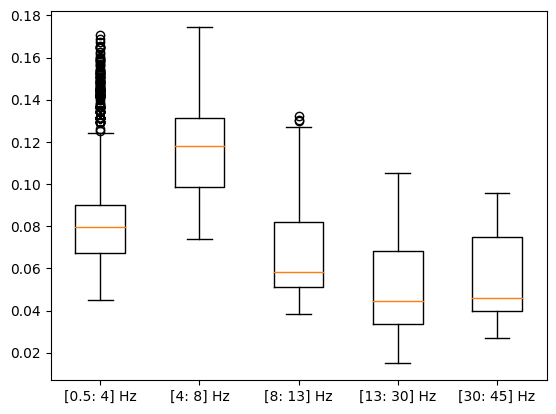

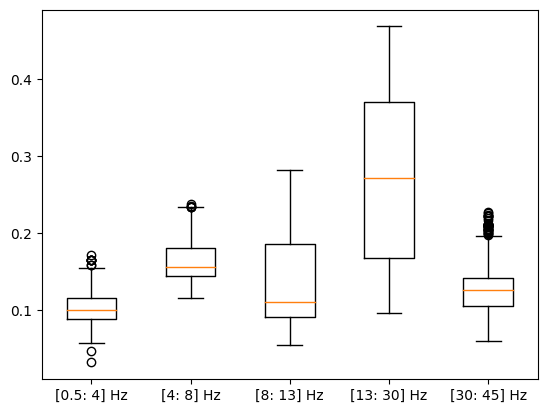

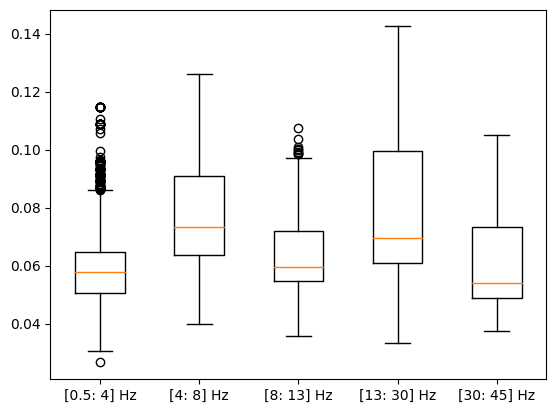

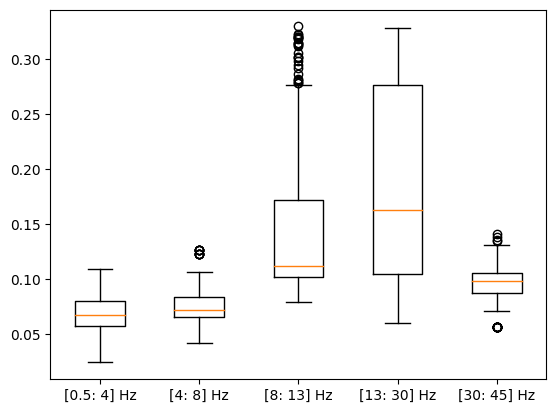

...

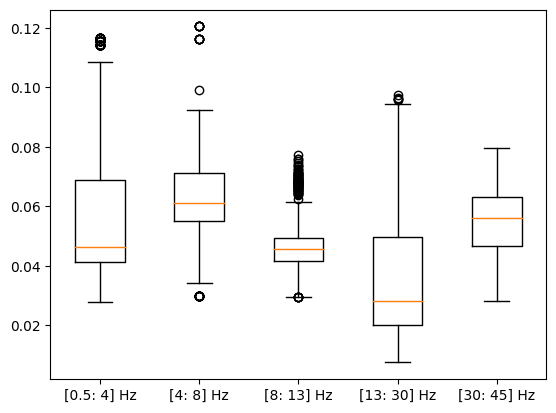

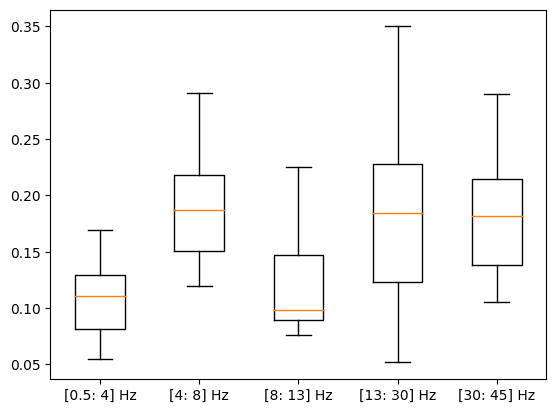

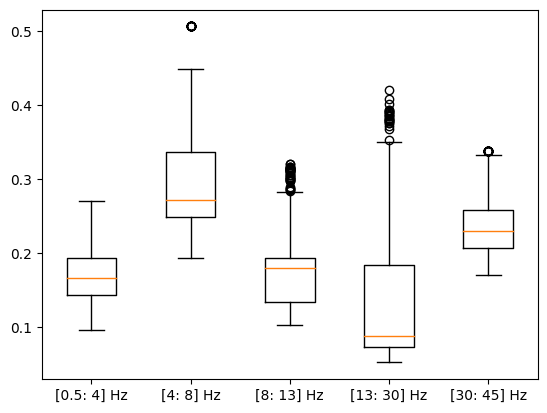

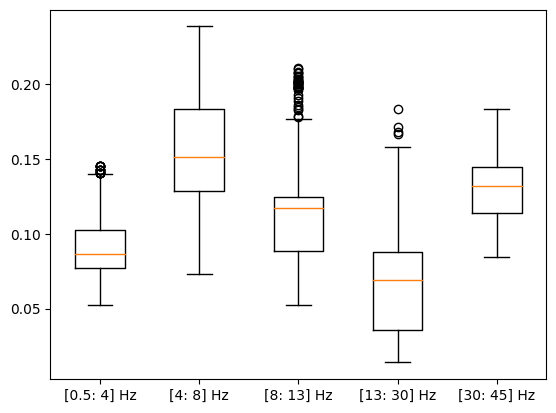

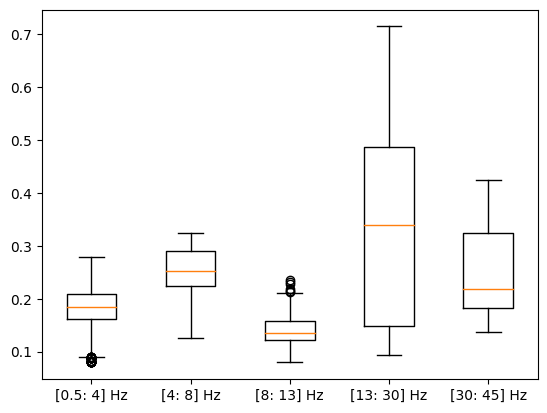

In [48]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

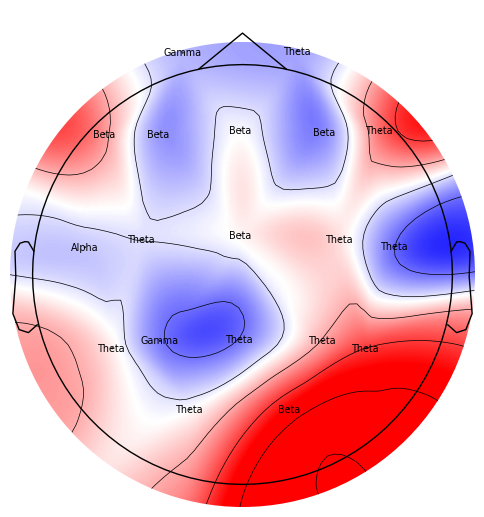

In [49]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [50]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

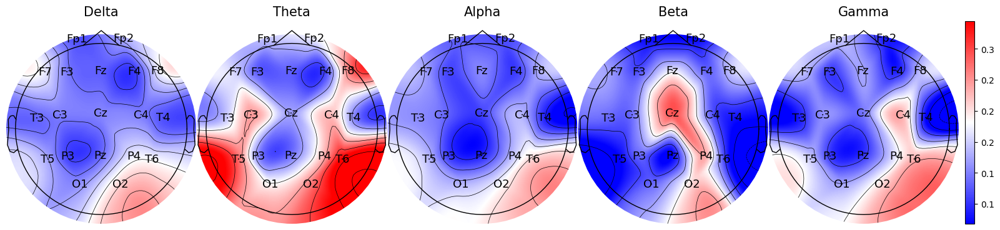

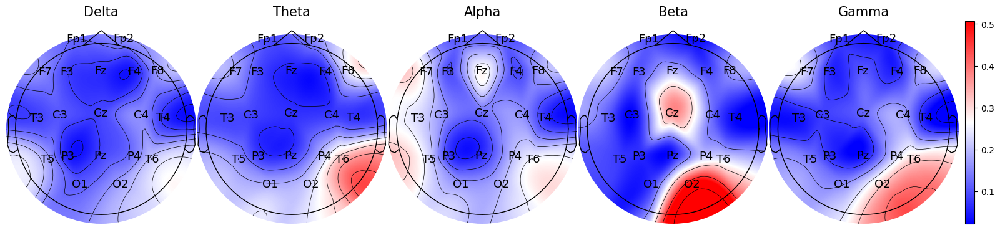

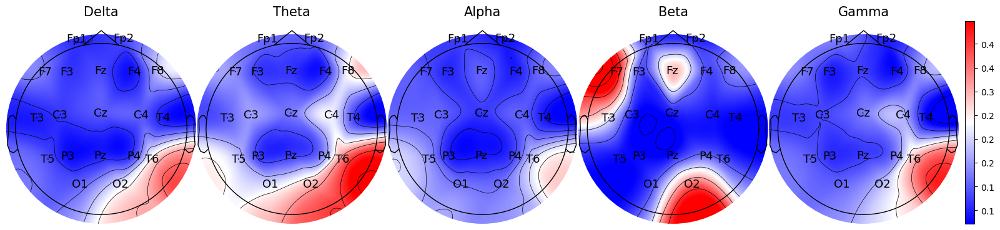

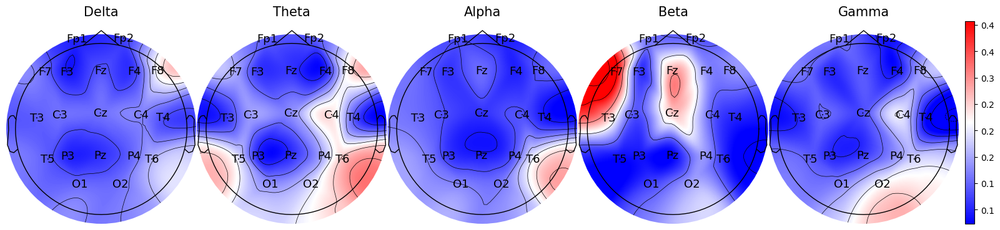

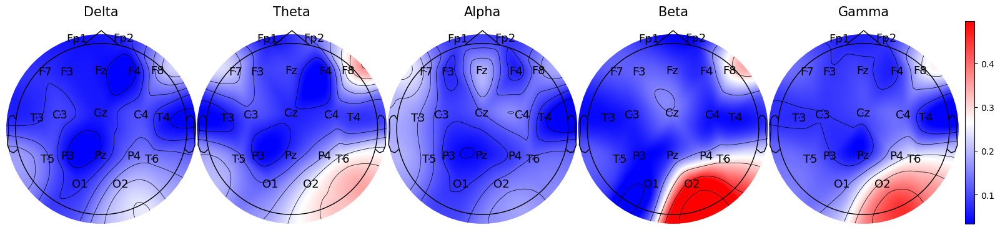

In [51]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="800_"+str(rand_idx))

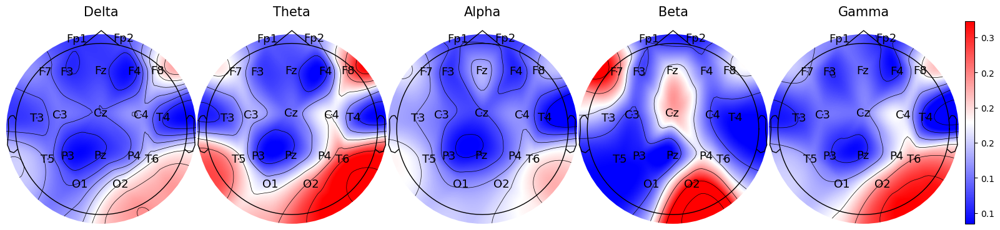

In [52]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="800_avg")

In [53]:
edge_importances = []
for i in tqdm(range(test_X.shape[0])):
    edge_imp = build_maps(X=test_X, graphs=test_graphs, y=test_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|██████████████████████████████████████| 1802/1802 [00:05<00:00, 325.68it/s]


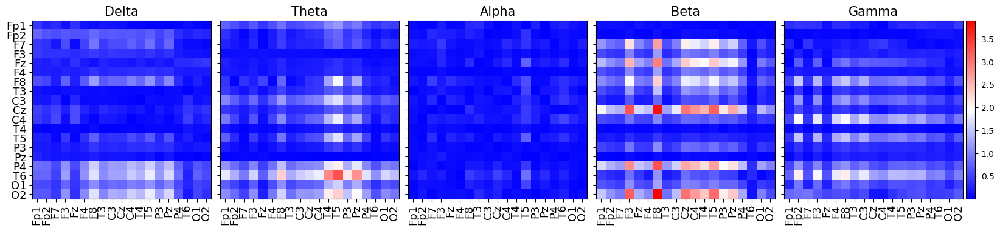

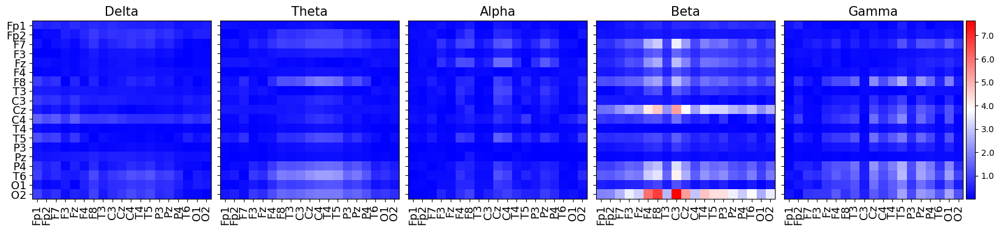

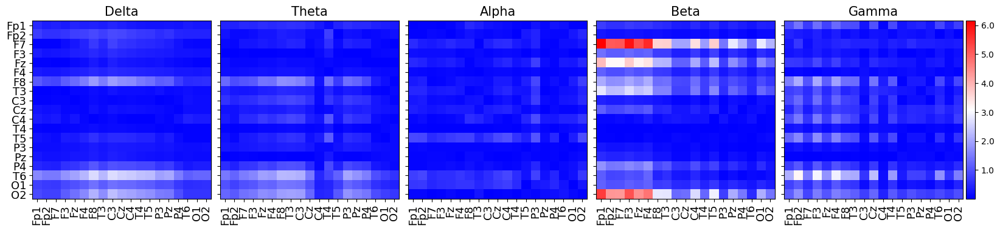

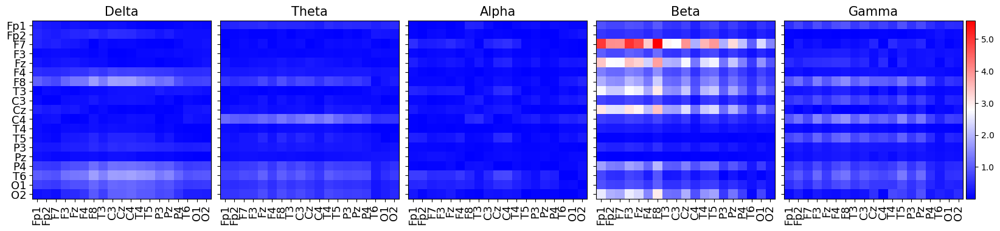

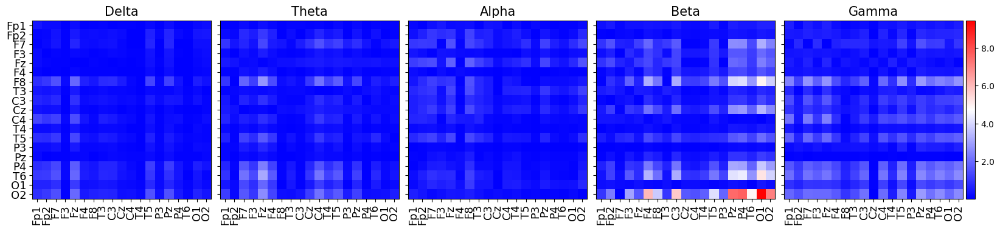

In [54]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="800_"+str(rand_idx))

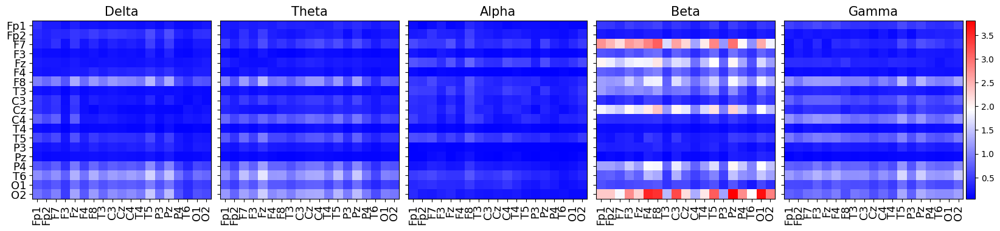

In [55]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="800_avg")

## Window size : 2000. Classification of Control vs MCI

In [56]:
train_X, train_graphs, train_y = build_data(train_data_files, size=2000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=2000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|████████████████████████████████████████| 693/693 [00:02<00:00, 281.06it/s]


In [57]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:05<00:00,  3.72it/s]


In [58]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9940417080436942
Precision:  [0.99162011 1.        ]
Recall:  [1.         0.97979798]
F1:  [0.99579243 0.98979592]
Confusion Matrix:  [[710   0]
 [  6 291]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[452   0]
 [  0 241]]


In [59]:
node_importances = []
for i in tqdm(range(test_X.shape[0])):
    node_imp=build_maps(X=test_X, graphs=test_graphs, y=test_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)

100%|████████████████████████████████████████| 693/693 [00:02<00:00, 342.32it/s]


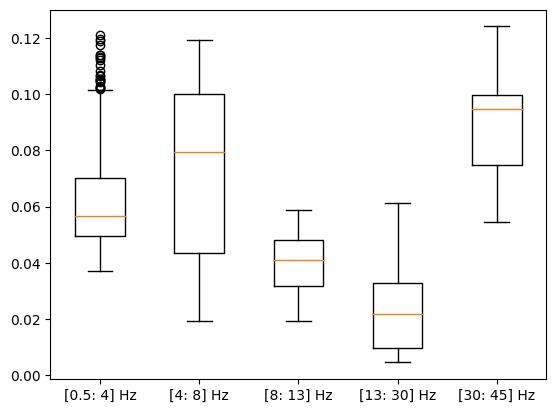

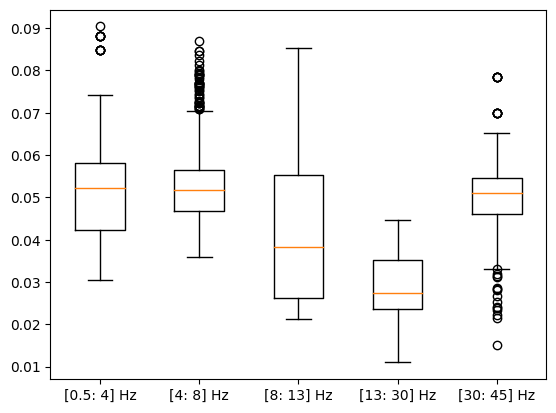

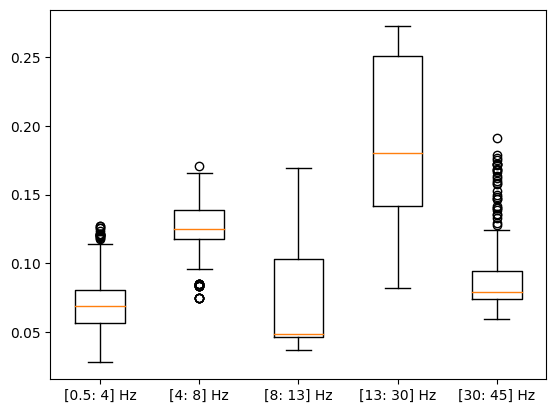

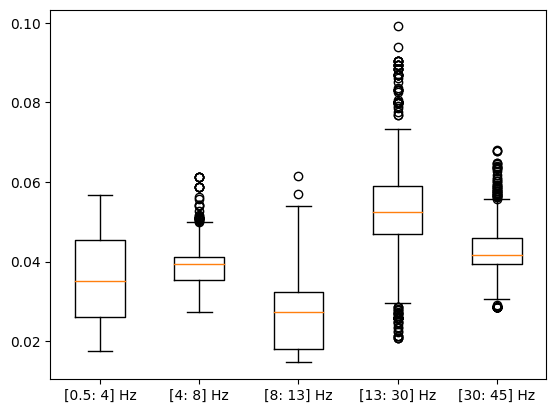

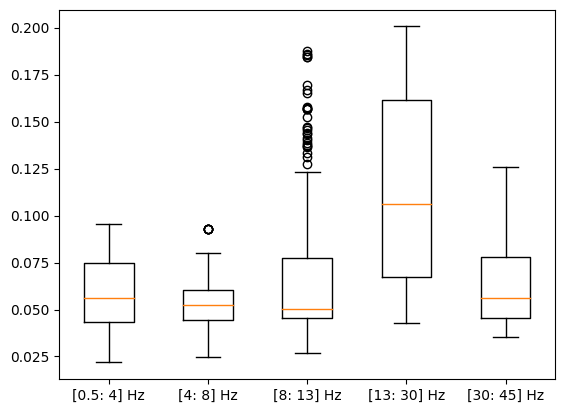

...

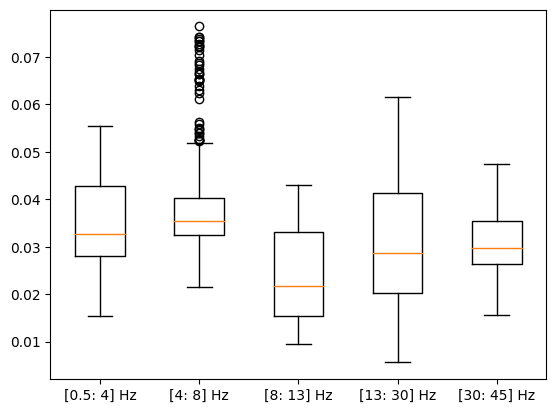

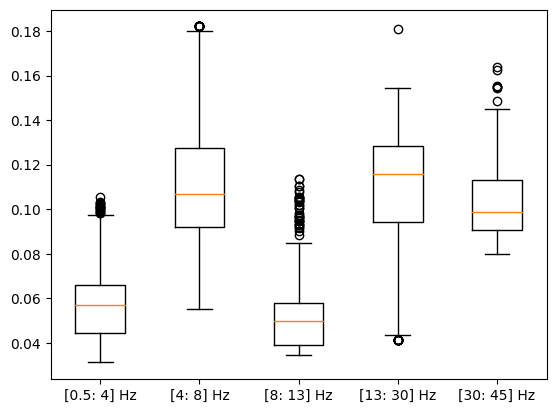

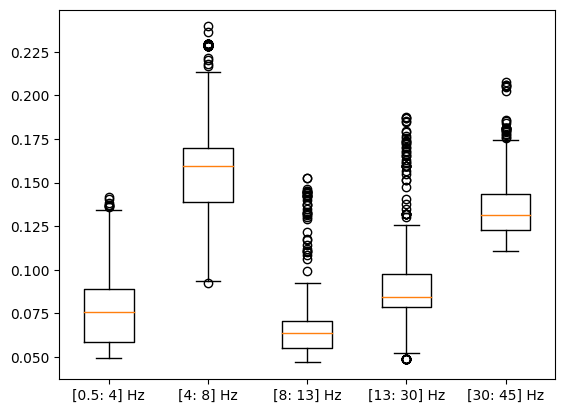

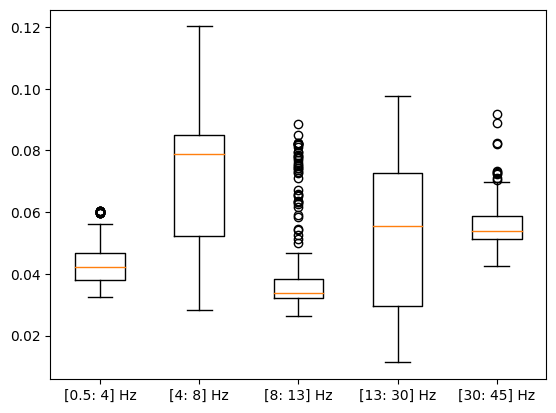

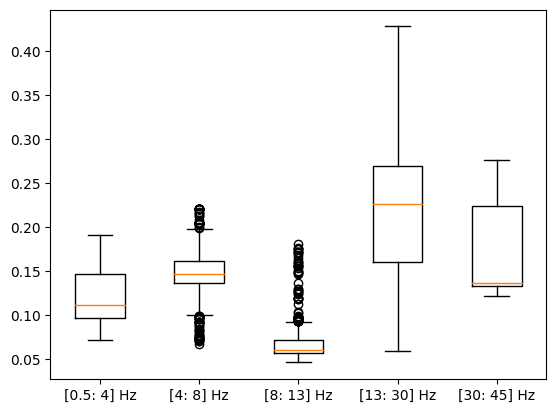

In [60]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)


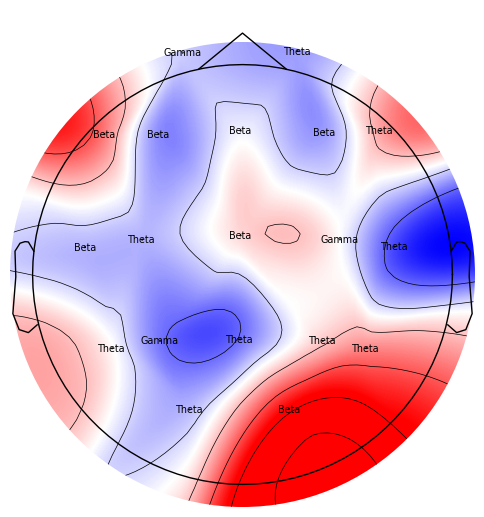

In [61]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [62]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

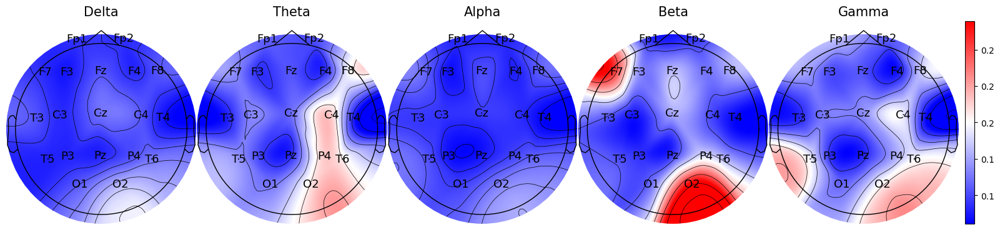

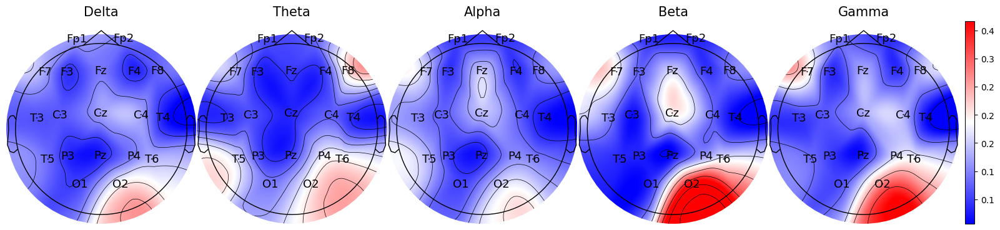

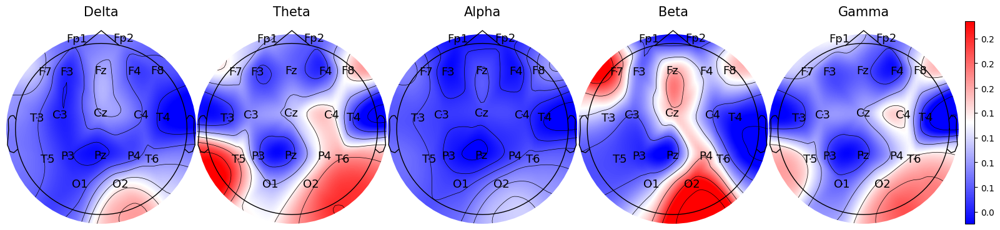

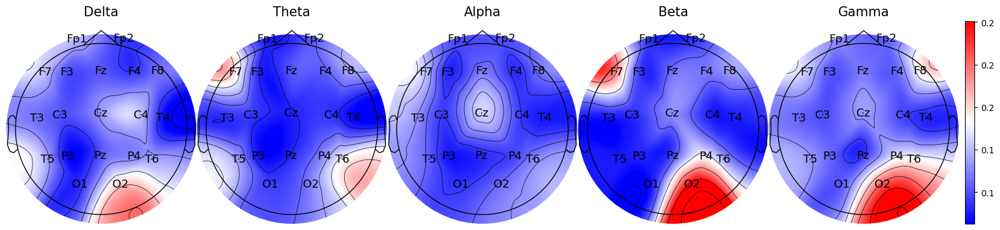

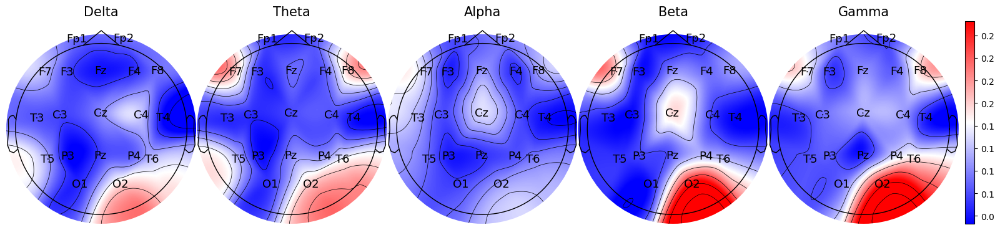

In [63]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="2000_"+str(rand_idx))

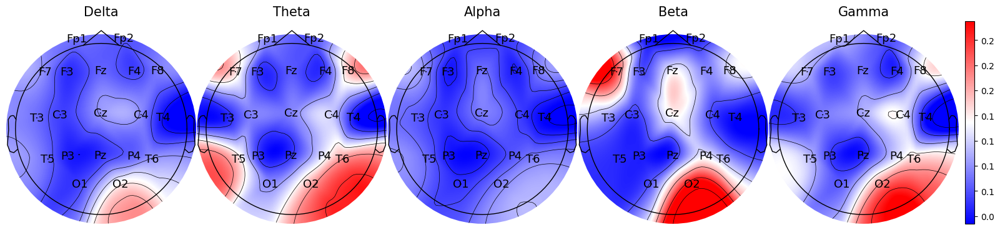

In [64]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="2000_avg")

In [65]:
edge_importances = []
for i in tqdm(range(test_X.shape[0])):
    edge_imp = build_maps(X=test_X, graphs=test_graphs, y=test_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|████████████████████████████████████████| 693/693 [00:02<00:00, 329.31it/s]


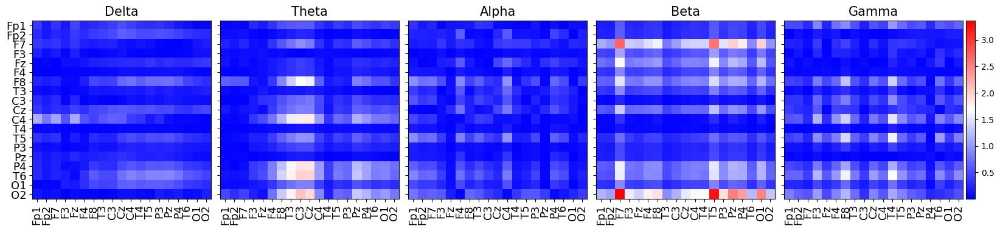

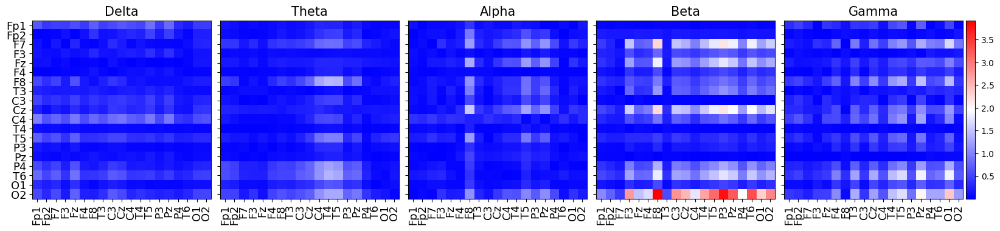

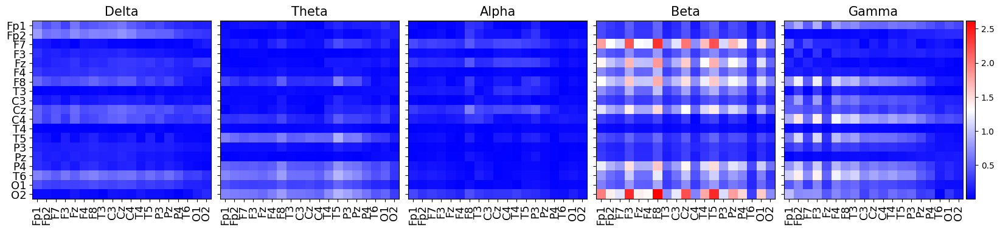

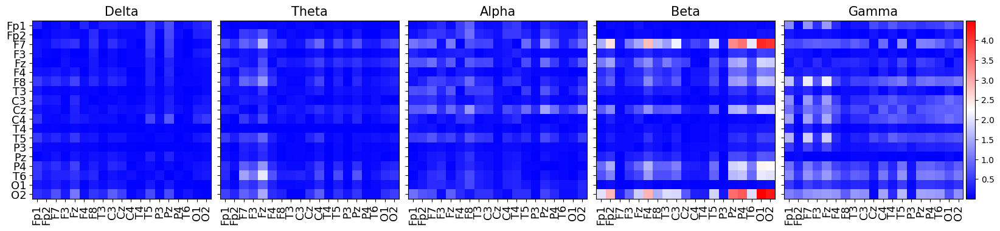

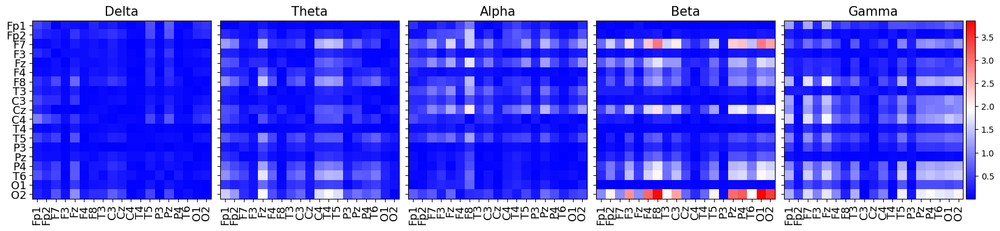

In [66]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="2000_"+str(rand_idx))

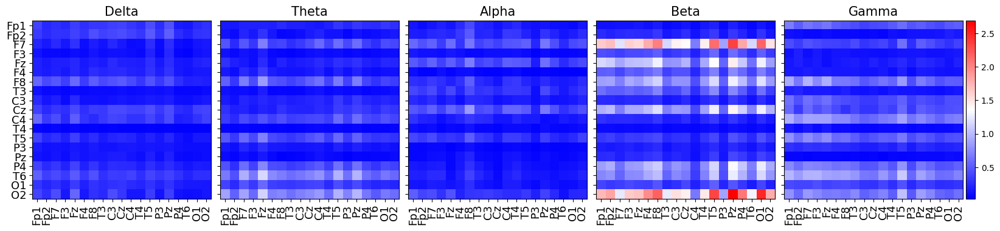

In [67]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="2000_avg")

## Window size : 3000. Classification of Control vs MCI

In [68]:
train_X, train_graphs, train_y = build_data(train_data_files, size=3000, cal_conn="corr", bands=True)
test_X, test_graphs, test_y = build_data(test_data_files, size=3000, cal_conn="corr", bands=True)
train_X_orig, train_graphs_orig, train_y_orig = stack_arrays(train_X, train_graphs, train_y)
test_X_orig, test_graphs_orig, test_y_orig = stack_arrays(test_X, test_graphs, test_y)

train_graphs, train_X, train_y =  label2skip(train_graphs_orig, train_X_orig, train_y_orig, skip_label=1)
test_graphs, test_X, test_y =  label2skip(test_graphs_orig, test_X_orig, test_y_orig, skip_label=1)
train_graphs, test_graphs = uniform(train_graphs, test_graphs)
train_X, test_X = standardize_data(train_X, test_X)
train_graphs = get_lap(train_graphs)
test_graphs = get_lap(test_graphs)

100%|████████████████████████████████████████| 448/448 [00:01<00:00, 275.49it/s]


In [69]:
encoder = OneHotEncoder()
train_y_ohe = encoder.fit_transform(train_y).toarray()
test_y_ohe = encoder.transform(test_y).toarray()

train_iter = data_loader(train_X, train_graphs, train_y_ohe, DEVICE, BATCH_SIZE, shuffle=True)
test_iter = data_loader(test_X, test_graphs, test_y_ohe, DEVICE, BATCH_SIZE, shuffle=False)

model = trainer(20, train_iter)

Training Model....


100%|███████████████████████████████████████████| 20/20 [00:04<00:00,  4.71it/s]


In [70]:
print("Train Accuracy")
train_acc = cal_accuracy(model, train_iter)
print("Accuracy: ", train_acc[0])
print("Precision: ", train_acc[2])
print("Recall: ", train_acc[3])
print("F1: ", train_acc[4])
print("Confusion Matrix: ", train_acc[1])

print("Test Accuracy")
test_acc = cal_accuracy(model, test_iter)
print("Accuracy: ", test_acc[0])
print("Precision: ", test_acc[2])
print("Recall: ", test_acc[3])
print("F1: ", test_acc[4])
print("Confusion Matrix: ", test_acc[1])

Train Accuracy
Accuracy:  0.9861538461538462
Precision:  [0.98056156 1.        ]
Recall:  [1.         0.95408163]
F1:  [0.99018539 0.97650131]
Confusion Matrix:  [[454   0]
 [  9 187]]
Test Accuracy
Accuracy:  1.0
Precision:  [1. 1.]
Recall:  [1. 1.]
F1:  [1. 1.]
Confusion Matrix:  [[288   0]
 [  0 160]]


In [71]:
node_importances = []
for i in tqdm(range(test_X.shape[0])):
    node_imp=build_maps(X=test_X, graphs=test_graphs, y=test_y, 
                        subject_idx=i, map_kind="node", test_model=model)
    node_importances.append(node_imp)
node_importances = np.array(node_importances)
node_importances_avg = np.mean(node_importances, 2)

100%|████████████████████████████████████████| 448/448 [00:01<00:00, 334.18it/s]


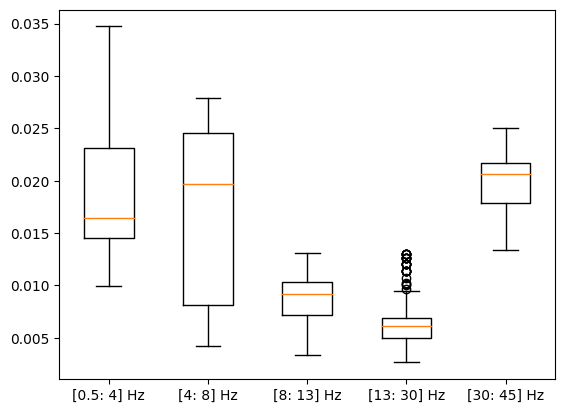

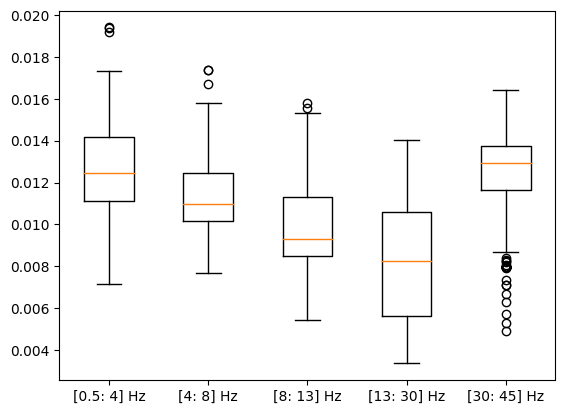

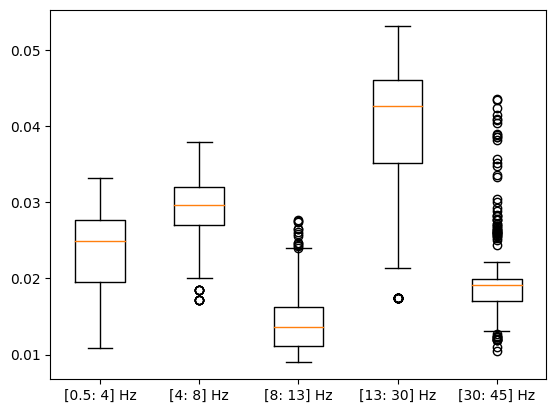

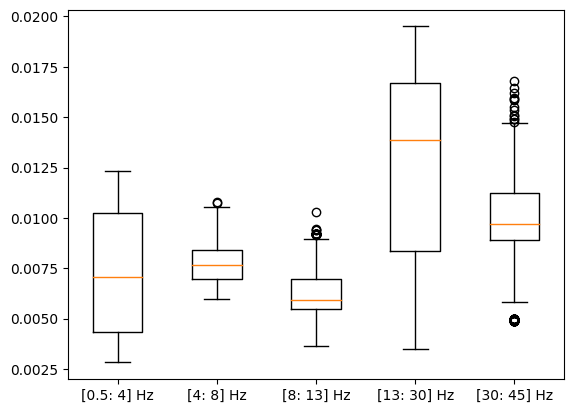

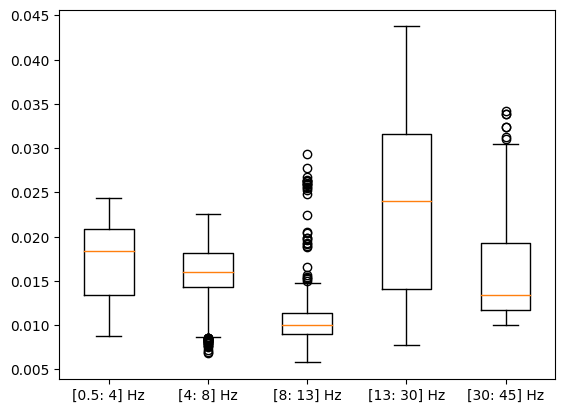

...

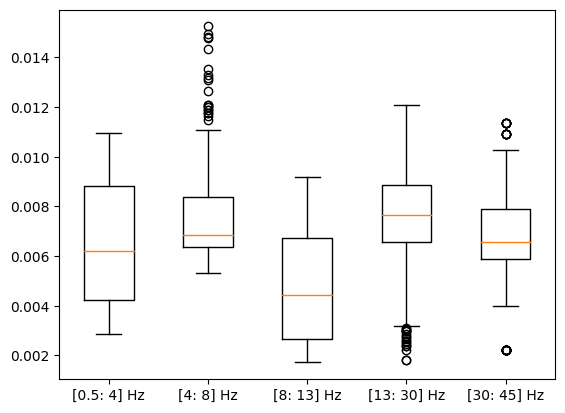

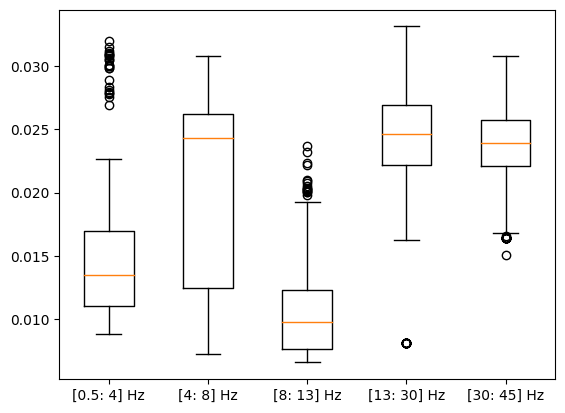

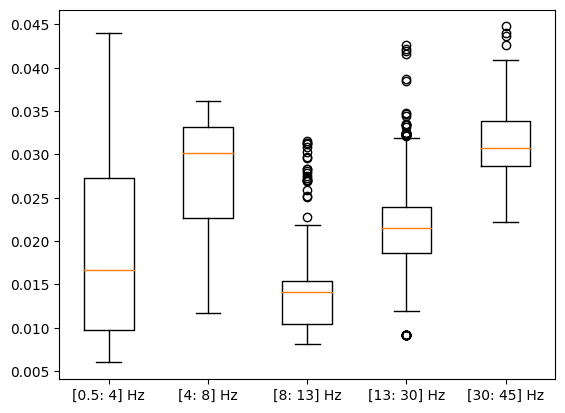

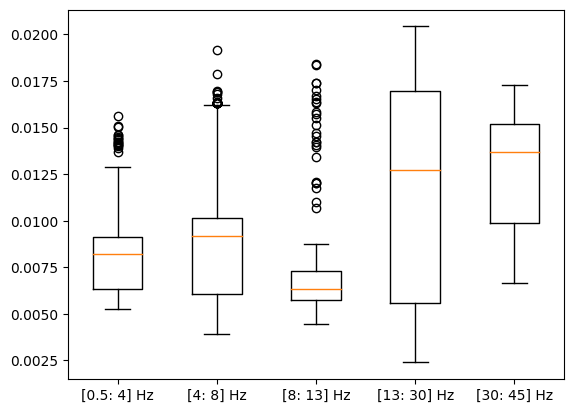

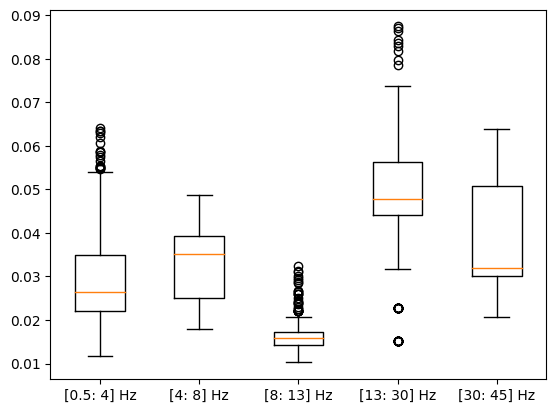

In [72]:
xticks = ['[0.5: 4] Hz', '[4: 8] Hz', '[8: 13] Hz', '[13: 30] Hz', '[30: 45] Hz']
node_importances_avg = np.mean(node_importances, 2)
for i  in range(19):
    fig, ax = plt.subplots()
    ax.boxplot(node_importances_avg[:, i, :])
    ax.set_xticklabels(xticks)

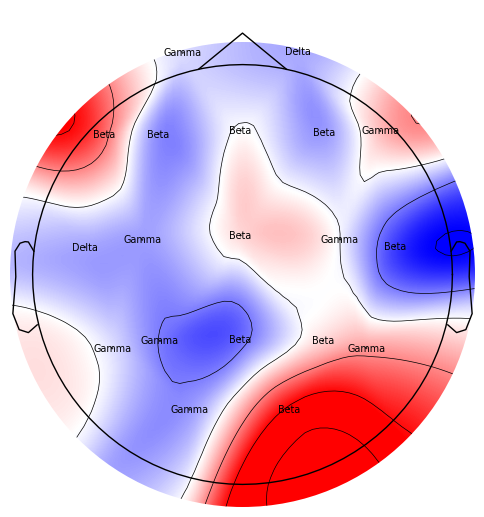

In [73]:
from plot import plot_bands_per_regions
node_importances_avg = np.mean(node_importances_avg, 0)
bands_names = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
maxs = np.argmax(node_importances_avg, -1)
maxm_means2bands = [bands_names[max_mean_band] for max_mean_band in maxs]
plot_bands_per_regions(node_importances_avg, maxm_means2bands)

In [74]:
import random
random.seed(42)   
RANDOM_WINDOWS = [] 
for i in range(5):
    RANDOM_WINDOWS.append(random.randint(0, node_importances.shape[0]))

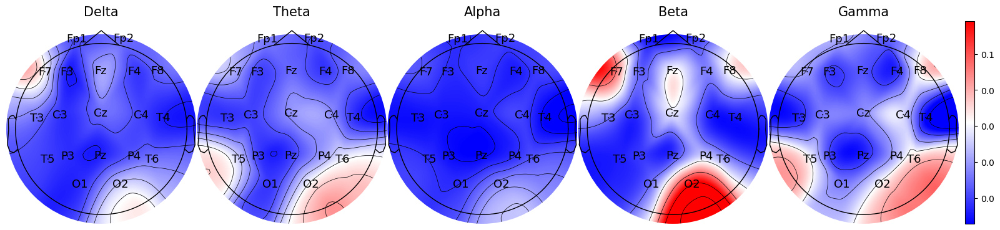

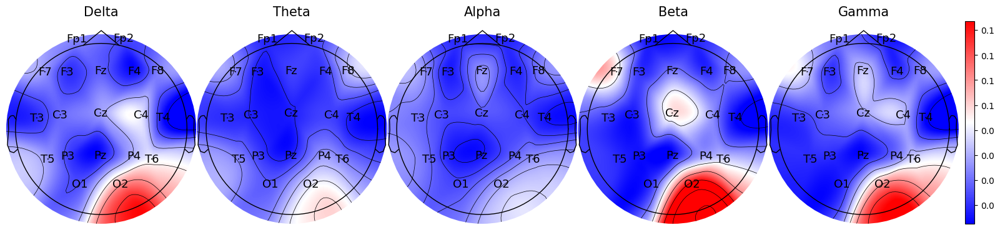

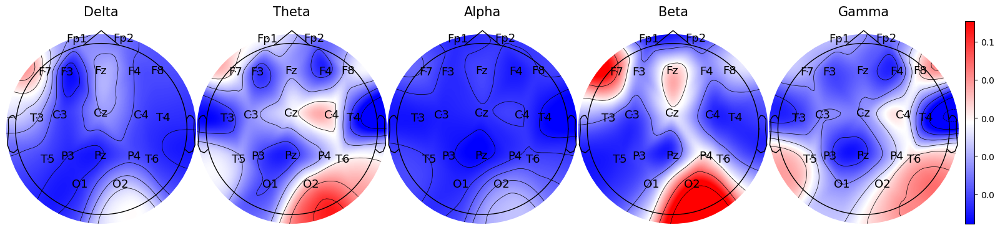

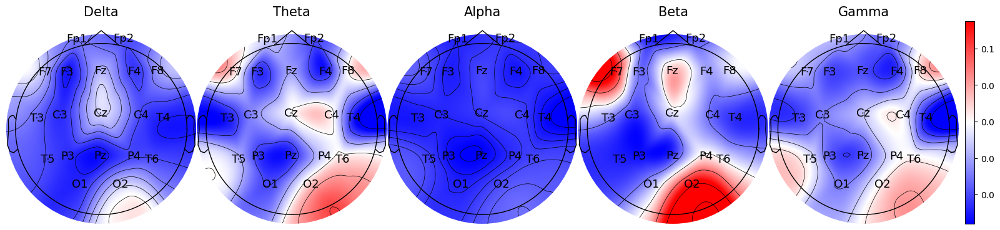

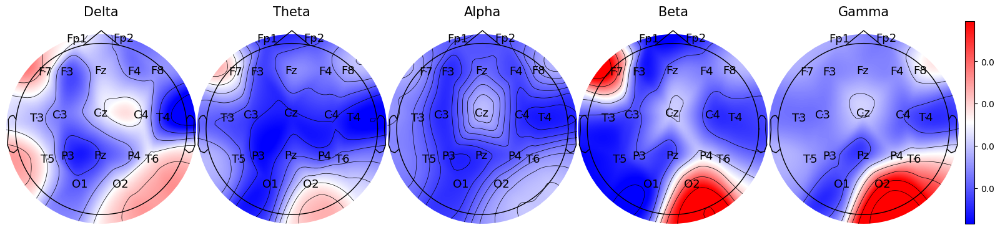

In [75]:
node_importances = np.mean(node_importances, axis=2)
for rand_idx in RANDOM_WINDOWS:
    plot_frequency_bands_graphs(node_importances[rand_idx, :], sub="3000_"+str(rand_idx))

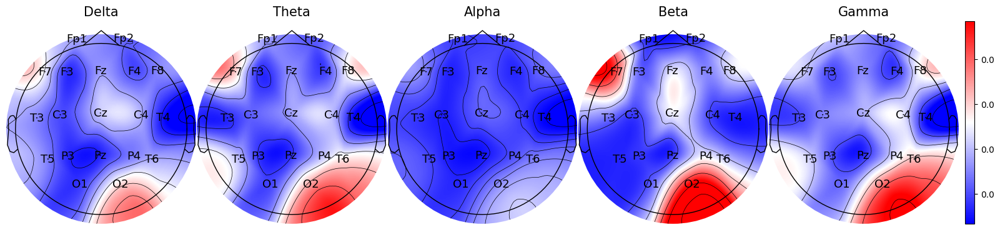

In [76]:
node_importances = np.mean(node_importances, axis=0)
plot_frequency_bands_graphs(node_importances, sub="3000_avg")

In [77]:
edge_importances = []
for i in tqdm(range(test_X.shape[0])):
    edge_imp = build_maps(X=test_X, graphs=test_graphs, y=test_y, 
               subject_idx=i, map_kind="edge", test_model=model)
    edge_importances.append(edge_imp)
edge_importances = np.array(edge_importances)

100%|████████████████████████████████████████| 448/448 [00:01<00:00, 331.52it/s]


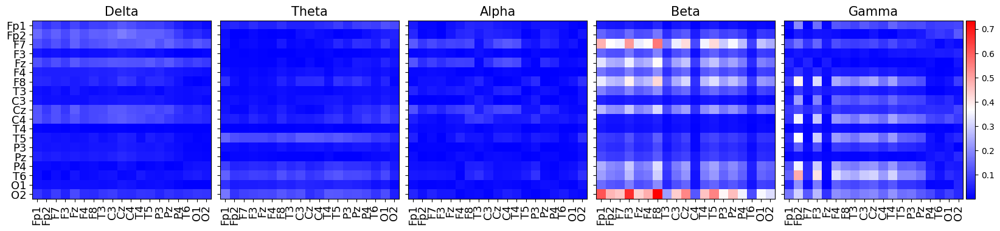

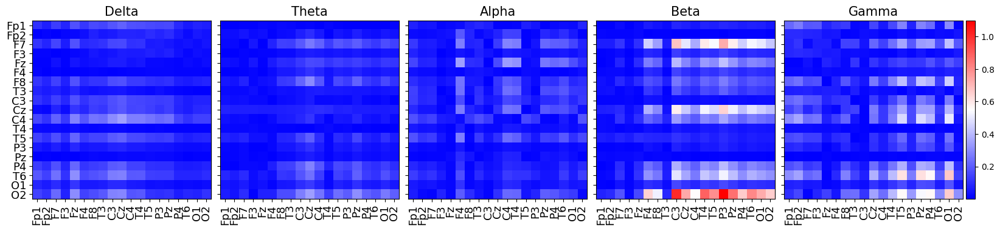

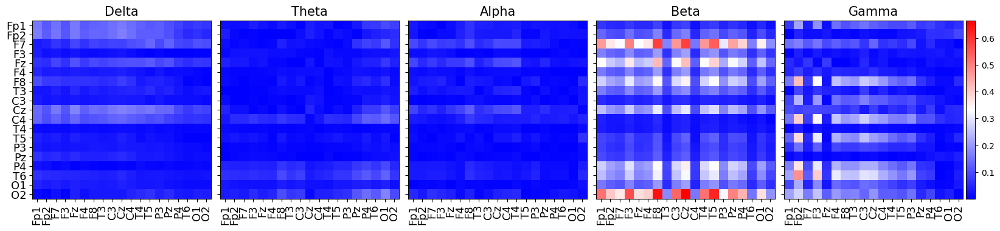

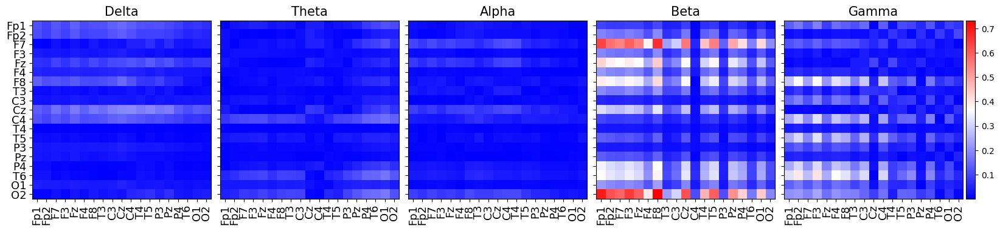

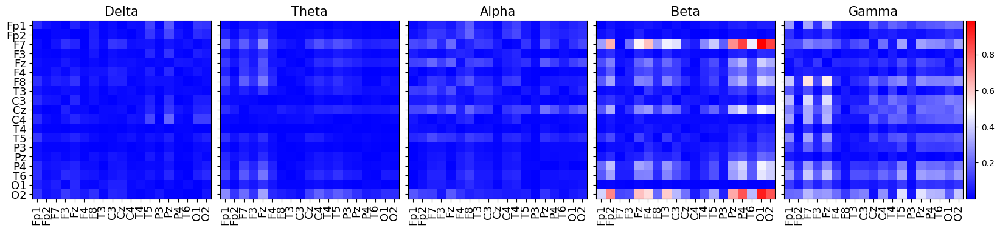

In [78]:
for rand_idx in RANDOM_WINDOWS:
    plot_edges(edge_importances[rand_idx], sub="3000_"+str(rand_idx))

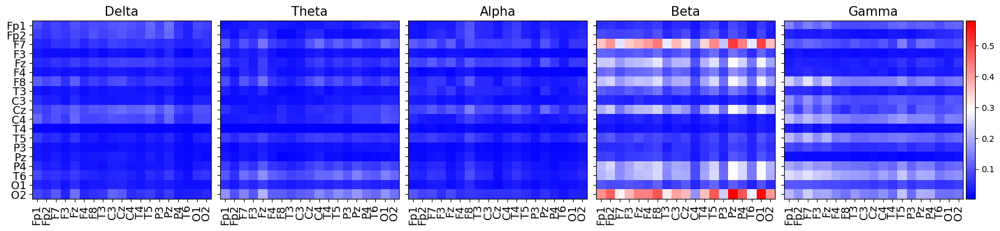

In [79]:
edge_importances = np.mean(edge_importances, axis=0)
plot_edges(edge_importances, sub="3000_avg")